<a href="https://colab.research.google.com/github/Sudeep-KS/Capstone-Style-Transfer-Using-GAN/blob/main/Capstone_Style_Transfer_Using_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Style Transfer Using CycleGAN**

Sudeep K S ML C38

Misdiagnosis in the medical field is a very serious issue but it’s also uncomfortably common to occur. Imaging procedures in the medical field requires an expert radiologist’s opinion since interpreting them is not a simple binary process ( Normal or Abnormal). Even so, one radiologist may see something that another does not. This can lead to conflicting reports and make it difficult to effectively recommend treatment options to the patient.

One of the complicated tasks in medical imaging is to diagnose MRI(Magnetic Resonance Imaging). Sometimes to interpret the scan, the radiologist needs different variations of the imaging which can drastically enhance the accuracy of diagnosis by providing practitioners with a more comprehensive understanding.

But to have access to different imaging is difficult and expensive. With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.

In this capstone, you will use CycleGAN to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs you will create T2 weighted images from T1 weighted MRI image and vice-versa.

-Problem statement: To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

-The project pipeline can be briefly summarized in the following four steps:

-Data Understanding: Here, you need to load the data and create the dataset for it. Image Processing: In this step, you will have to process the images using different steps. Model-Building and Training: This is the final step at which you have to create your Generators and Discriminators using a modified U-Net architecture(similar to CycleGAN). You also have to define the loss function and training step for model training.

In [52]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
import imageio
import glob

In [53]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [54]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 833488767566793933
 xla_global_id: -1,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14343274496
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 3834672191851231662
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
 xla_global_id: 416903419]

##**Importing Images**

In [55]:
from google.colab import drive
drive.mount('/content/drive')

## Getting T1 images
filenames = glob.glob('/content/drive/MyDrive/Capstone/Data/TrainT1/Image*.png')

t1_images = []
for filename in filenames:
    image = imageio.v2.imread(filename)
    t1_images.append(image)

t1_images = np.array(t1_images)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [56]:
## Shape of T1 images

t1_images.shape

(43, 217, 181)

In [57]:
## Getting T2 images

filenames = glob.glob('/content/drive/MyDrive/Capstone/Data/TrainT2/Image*.png')

t2_images = []
for filename in filenames:
    image = imageio.v2.imread(filename)
    t2_images.append(image)

t2_images = np.array(t2_images)

In [58]:
## Shape of T2 images

t2_images.shape

(46, 217, 181)

In [59]:
## Setting batch size

BATCH_SIZE = 4

## Data Visualization
#### Total 43 images of T1 
#### Total 46 images of T2

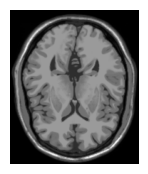

In [60]:
## Example of T1 Image

plt.figure(figsize=(2, 2))
plt.imshow(t1_images[0], cmap='gray')
plt.axis('off')
plt.show()

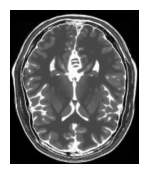

In [61]:
## Example of T2 Image

plt.figure(figsize=(2, 2))
plt.imshow(t2_images[0], cmap='gray')
plt.axis('off')
plt.show()

## Data Preprocessing
1. Data Normalisation
2. Resizing
3. Reshaping
4. Shuffling and Batching

### 1. Data Normalization

In [62]:
t1_images = (t1_images/127.5)-1.0 # Normalize the images to [-1.0, 1.0]
t1_images.shape

(43, 217, 181)

In [63]:
t2_images = (t2_images/127.5)-1.0 # Normalize the images to [-1.0, 1.0]
t2_images.shape

(46, 217, 181)

### 2. Resizing
We will be resizing the data to a shape of 216x176

In [64]:
## resizing T1 images

t1_images_data = np.zeros((t1_images.shape[0], 216, 176))
for index, img in enumerate(t1_images):
    t1_images_data[index, :, :] = resize(img, (216, 176))
t1_images_data.shape

(43, 216, 176)

In [65]:
## resizing T2 images

t2_images_data = np.zeros((t2_images.shape[0], 216, 176))
for index, img in enumerate(t2_images):
    t2_images_data[index, :, :] = resize(img, (216, 176))
t2_images_data.shape

(46, 216, 176)

### 3. Reshaping
This reshaped data is fed into the architecture

In [66]:
## reshaping to 216*176*1

t1_images_data = t1_images_data.reshape(t1_images_data.shape[0], 216, 176, 1).astype('float32')
t2_images_data = t2_images_data.reshape(t2_images_data.shape[0], 216, 176, 1).astype('float32')

### 4. Shuffling and Batching

In [67]:
t1_images_data = tf.data.Dataset.from_tensor_slices(t1_images_data).shuffle(t1_images.shape[0], seed=1).batch(BATCH_SIZE)
t2_images_data = tf.data.Dataset.from_tensor_slices(t2_images_data).shuffle(t2_images.shape[0], seed=1).batch(BATCH_SIZE)

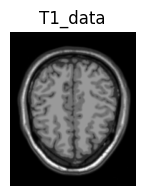

In [68]:
## T1 sample visualisation

sample_t1_images_data = next(iter(t1_images_data))
plt.figure(figsize=(2, 2))
plt.imshow(sample_t1_images_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('T1_data')
plt.axis('off')
plt.show()

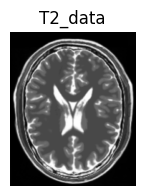

In [69]:
## T2 sample visualisation

sample_t2_images_data = next(iter(t2_images_data))
plt.figure(figsize=(2, 2))
plt.imshow(sample_t2_images_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('T2_data')
plt.axis('off')
plt.show()

## Model Building
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building


### 1. Instance Normalization
Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

In [70]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

### 2 Downsampling Upsampling & Unet
Downsampling is performed using the Convolution, leading to reduce in dimensions.

Upsampling is a result of Transposed Convolution, where dimension of image are increased.

Unets takes Image as an input and translate it into another Image.
To do this they first use Downsampling on Input Image to learn the latent characteristics of Input Image and then use Upsampling to use this knowledge to Translate it into another Image.

In [71]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

In [72]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

In [73]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(64, 4,False), # (bs, 108, 88, 64)
        downsample(128, 4 ,False), # (bs, 54, 44, 128)
        downsample(256, 4), # (bs, 27, 22, 256)
    ]
    up_stack = [
        upsample(128, 4, True), # (bs, 54, 44, 128)
        upsample(64, 4, True), # (bs, 108, 88, 64)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 216, 176, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[216, 176, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

### 3. Generator
Generator is a Unet Network here since We want to translate One type of Image (T1) into Another type of Image (T2).

In [74]:
## initializing the generators

generator_g = unet_generator()
generator_f = unet_generator()

Visualize one of our Generator Models since Both our Generators have same architecture.
Notice How the dimension reduces first but then increases.

In [75]:
## summary of geenrator g
generator_g.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 216, 176, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_16 (Sequential)     (None, 108, 88, 64)  1024        ['input_3[0][0]']                
                                                                                                  
 sequential_17 (Sequential)     (None, 54, 44, 128)  131072      ['sequential_16[0][0]']          
                                                                                                  
 sequential_18 (Sequential)     (None, 27, 22, 256)  524800      ['sequential_17[0][0]']    

In [76]:
## summary of generator f
generator_f.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 216, 176, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential_21 (Sequential)     (None, 108, 88, 64)  1024        ['input_4[0][0]']                
                                                                                                  
 sequential_22 (Sequential)     (None, 54, 44, 128)  131072      ['sequential_21[0][0]']          
                                                                                                  
 sequential_23 (Sequential)     (None, 27, 22, 256)  524800      ['sequential_22[0][0]']    

### 4. Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence.
Both Discriminators have same architecture

In [77]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is not used 
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (216, 176, 1)
    inp = tf.keras.layers.Input(shape=[216 ,176, 1], name='input_image')
    x = inp
    
    # add downsampling step here
    down1 = downsample(64, 4, False)(x) # (bs, 108, 88, 64)
    down2 = downsample(128, 4)(down1) # (bs, 54, 44, 128)
    down3 = downsample(256, 4)(down2) # (bs, 27, 22, 256)
 
    # add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 29, 24, 256)
    
    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 26, 21, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    
    # apply zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 28, 23, 512)
    
    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 25, 20, 1)
    return tf.keras.Model(inputs=inp, outputs=last)

In [78]:
## initialisation of the discriminator

discriminator_x = discriminator()
discriminator_y = discriminator()

Have a look at Discriminator's architecture, Notice that The Dimensions are reducing overall at the end since it's a classifier and only Convolution layers are being used.

In [79]:
discriminator_x.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 216, 176, 1)]     0         
                                                                 
 sequential_26 (Sequential)  (None, 108, 88, 64)       1024      
                                                                 
 sequential_27 (Sequential)  (None, 54, 44, 128)       131328    
                                                                 
 sequential_28 (Sequential)  (None, 27, 22, 256)       524800    
                                                                 
 zero_padding2d_4 (ZeroPaddi  (None, 29, 24, 256)      0         
 ng2D)                                                           
                                                                 
 conv2d_25 (Conv2D)          (None, 26, 21, 512)       2097152   
                                                           

## Model Training
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Output of Untrained Generator models which should be a random noise

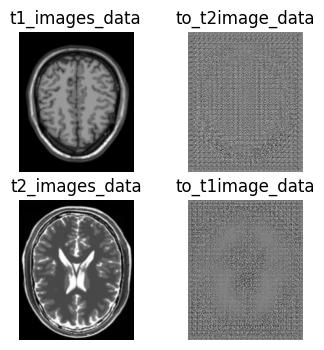

In [80]:
to_t2image_data = generator_g(sample_t1_images_data)
to_t1image_data = generator_f(sample_t2_images_data)
plt.figure(figsize=(4, 4))

imgs = [sample_t1_images_data, to_t2image_data, sample_t2_images_data, to_t1image_data]
title = ['t1_images_data', 'to_t2image_data', 't2_images_data', 'to_t1image_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

###1. Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier

In [81]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

###2. Discriminator Loss
It consists of two types of losses
*   Loss on Real Data
*  Loss on Fake Data




In [82]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

###3. Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [83]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

###4. Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [84]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

###5. Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

In [85]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss

###6. Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

In [86]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [87]:
## Running for 250 epochs

EPOCHS = 250

###7. Checkpoint Initialization
Initialize checkpoints to save models

In [88]:
checkpoint_path = "./Trained_Model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

**Function** to show Images output by Generators while Training

In [89]:
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

###8. Training Flow
Below Function performs one Flow of Batch Training

Notice that Identity Loss and Cycle Loss are only used in training Generator and not Discriminator

Sequence of Training Flow

1. Generate Fake Y and Cycled X
2. Generate Fake X and Cycled Y
3. Generate Fake Images through G and F for Identity Loss.
4. Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
5. Calculate Generator Loss on Discriminator.
6. Calculate Cycled Loss on Cycled Images from step 1 and 2.
7. Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8. Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9. Calculate the Gradients and update the weight and bias of models.

In [90]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

###Train the CycleGAN Model for several Epochs¶
Loop training function for number of epochs and also show the output at each step.

Note how Generators are getting better at producing realistic images epoch by epoch+

In [91]:
EPOCHS

250

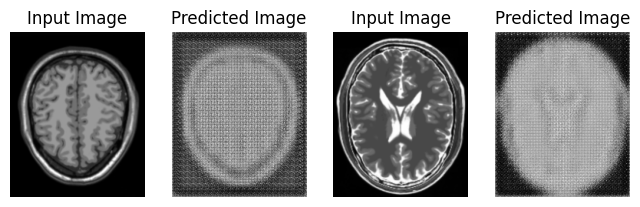

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-1


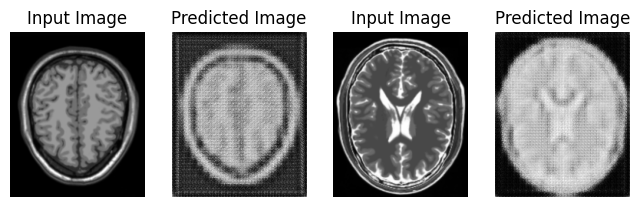

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-2


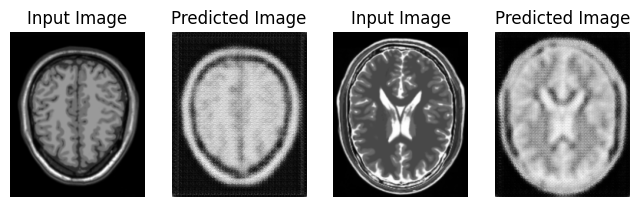

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-3


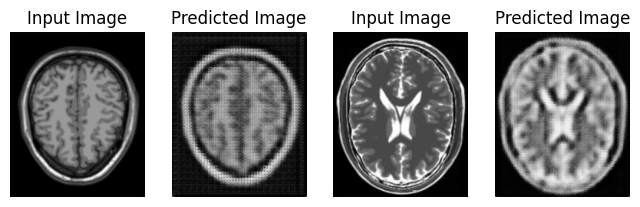

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-4


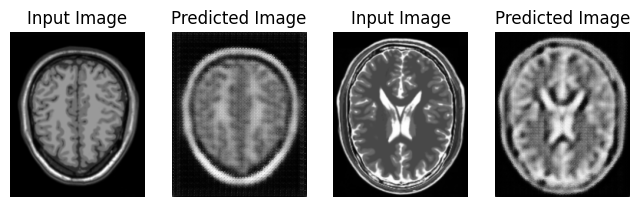

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-5


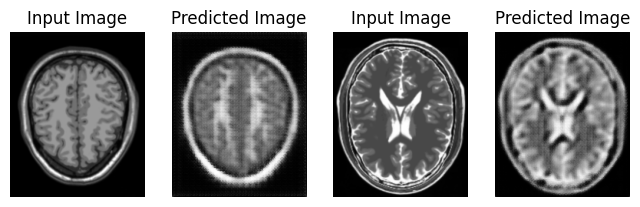

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-6


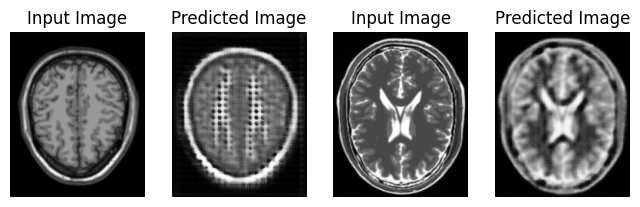

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-7


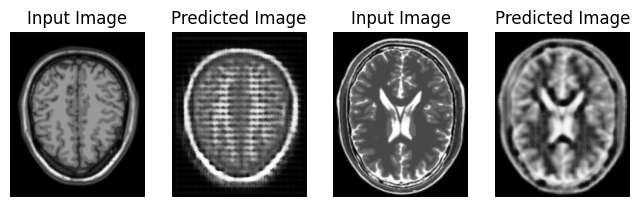

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-8


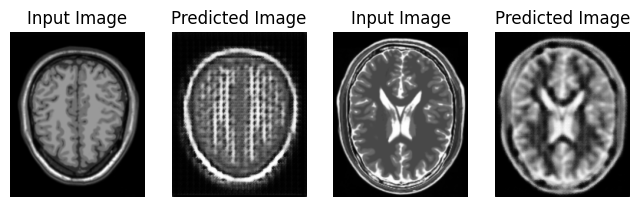

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-9


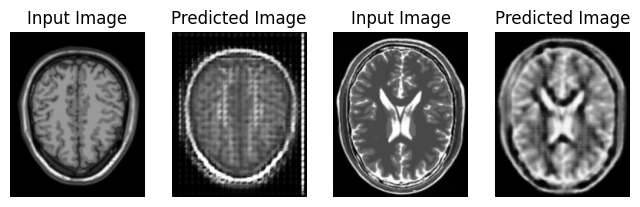

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-10


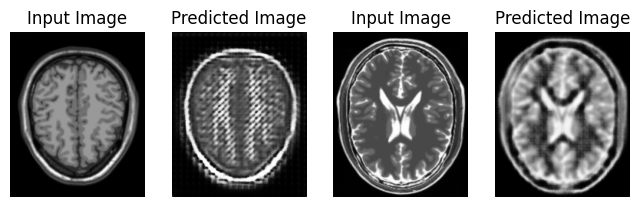

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-11


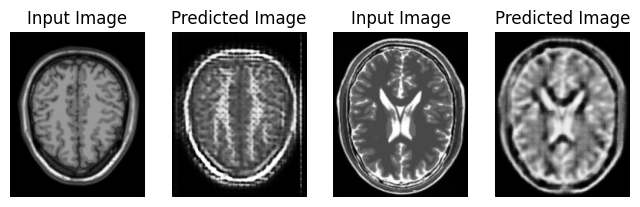

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-12


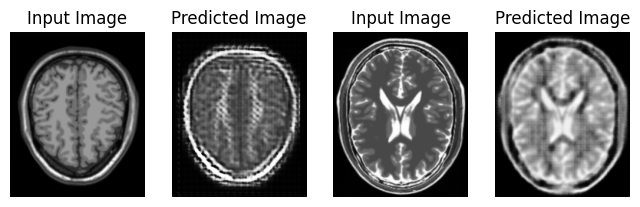

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-13


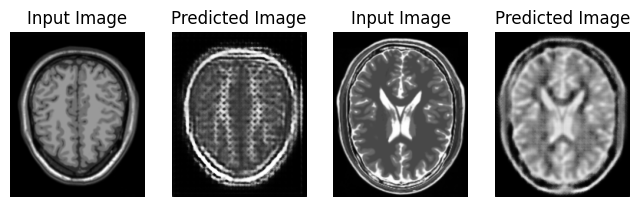

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-14


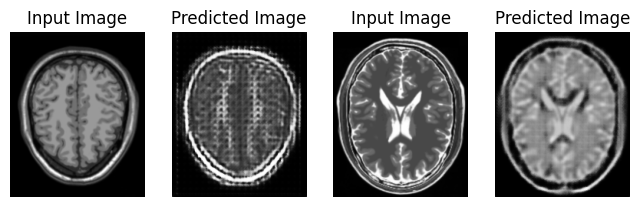

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-15


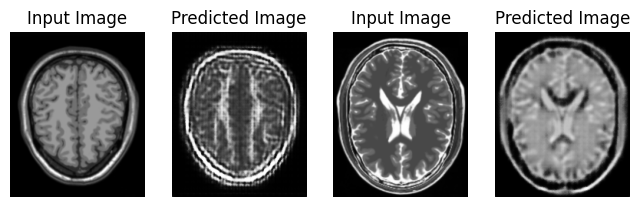

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-16


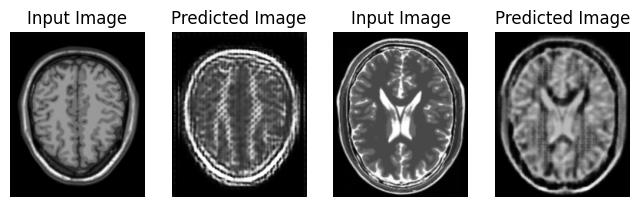

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-17


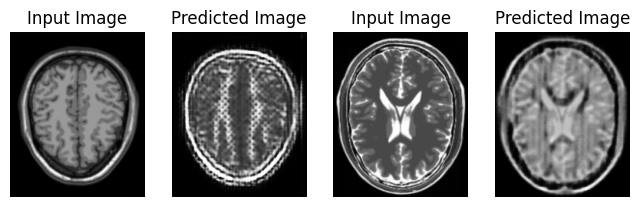

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-18


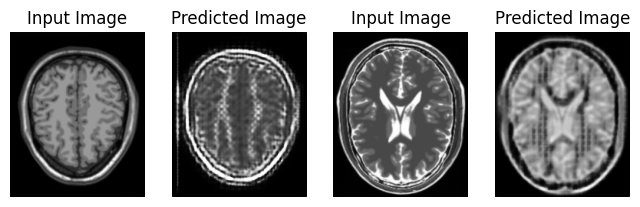

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-19


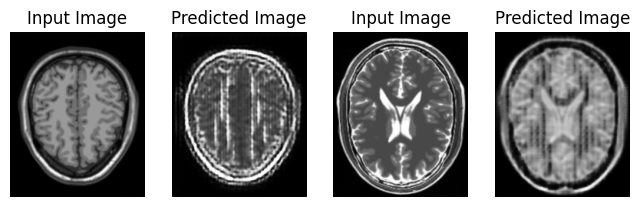

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-20


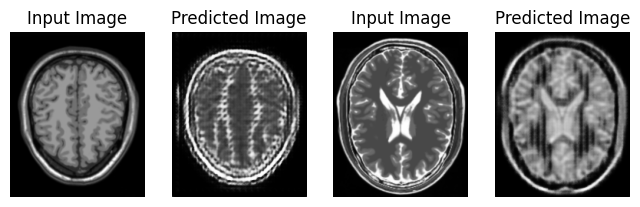

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-21


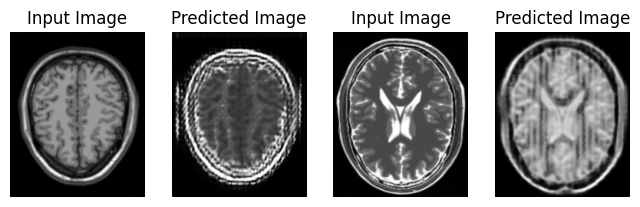

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-22


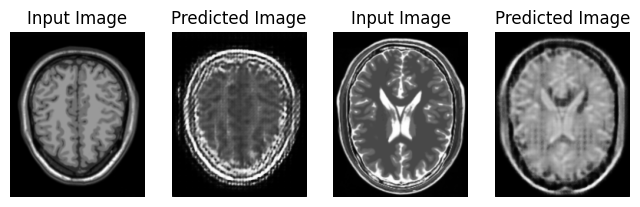

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-23


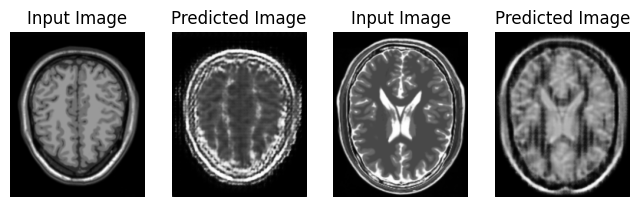

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-24


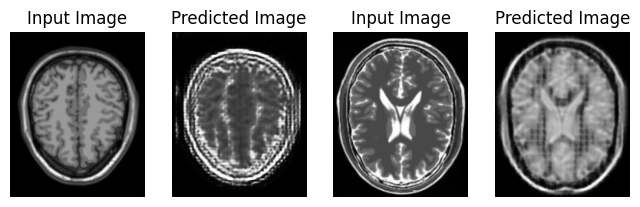

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-25


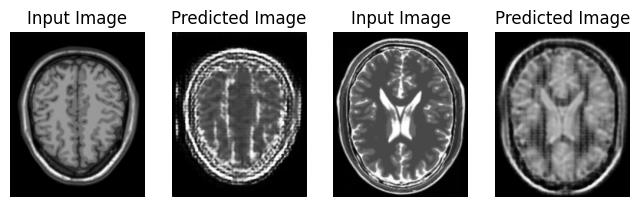

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-26


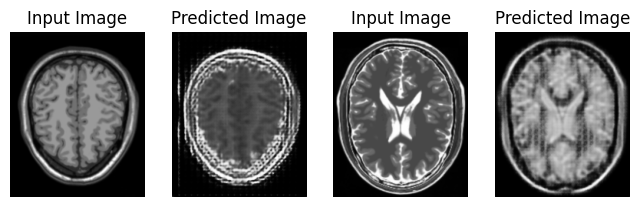

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-27


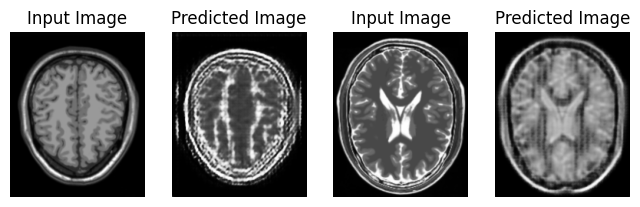

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-28


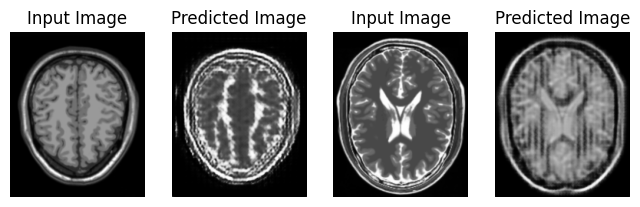

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-29


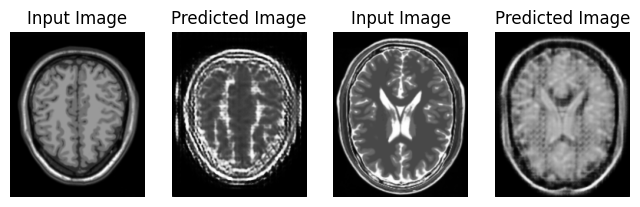

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-30


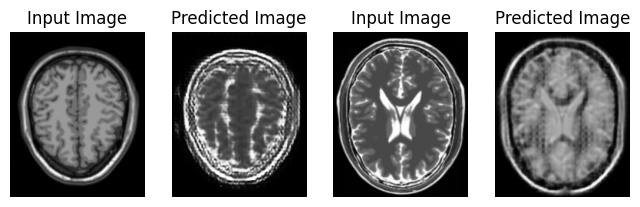

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-31


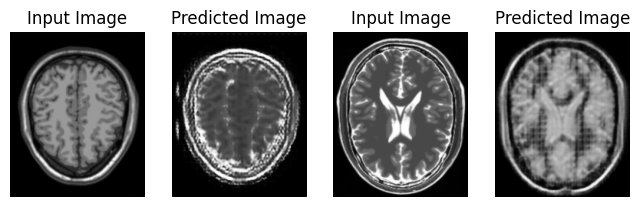

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-32


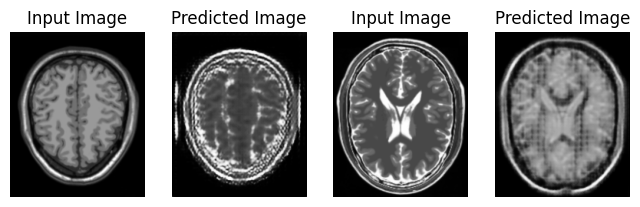

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-33


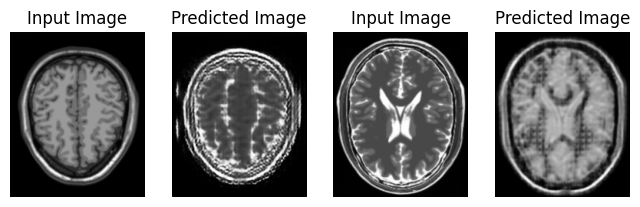

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-34


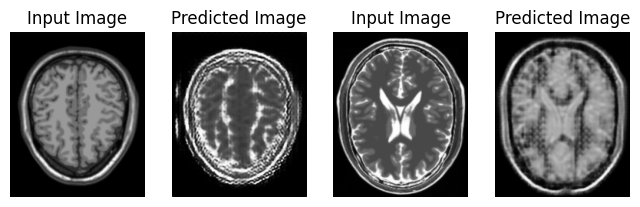

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-35


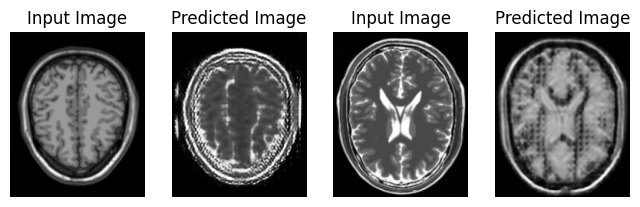

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-36


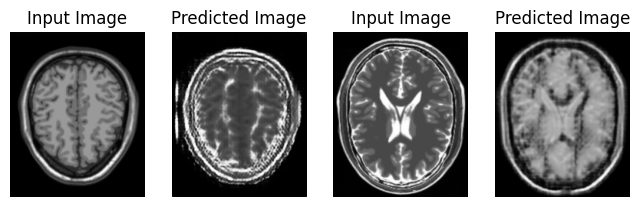

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-37


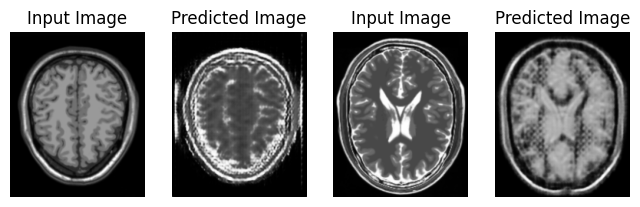

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-38


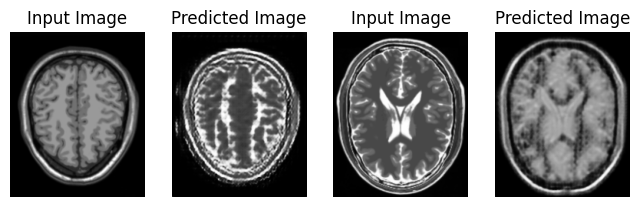

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-39


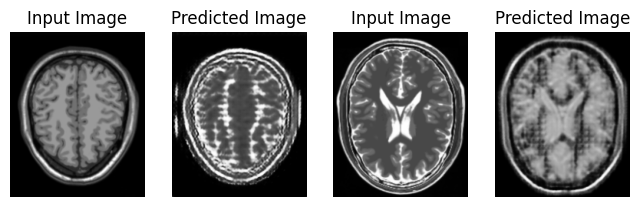

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-40


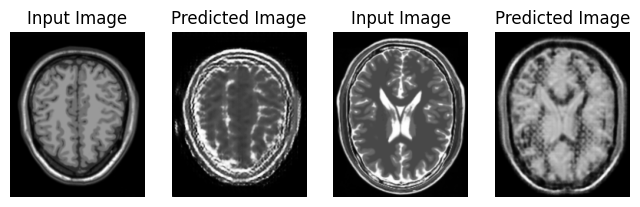

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-41


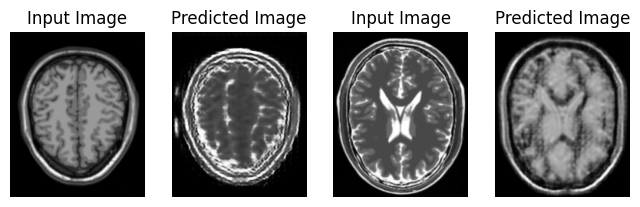

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-42


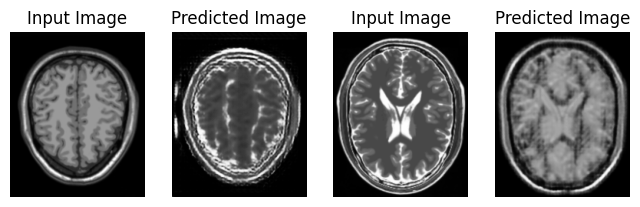

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-43


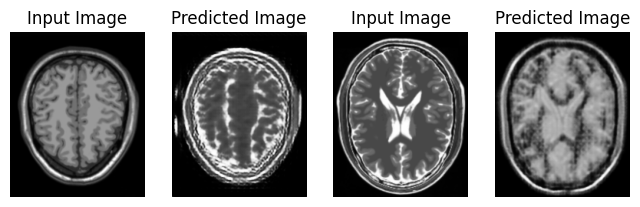

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-44


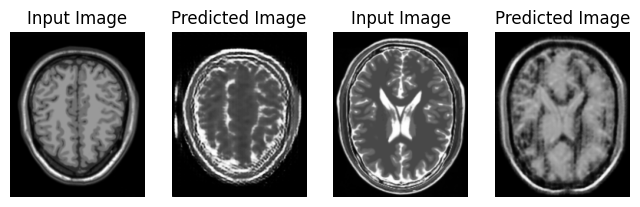

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-45


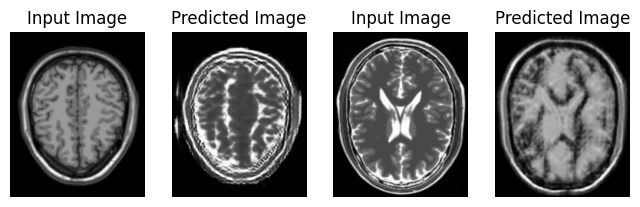

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-46


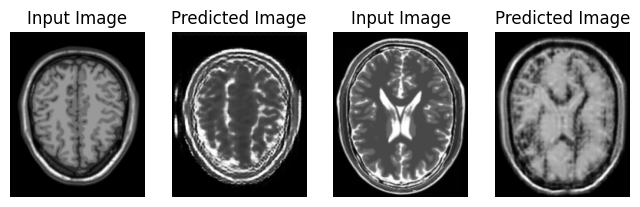

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-47


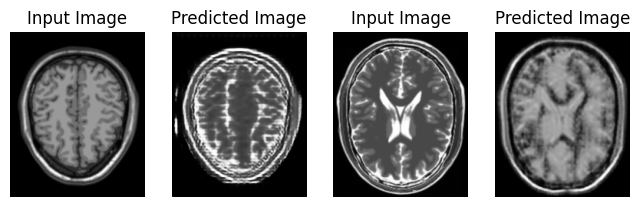

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-48


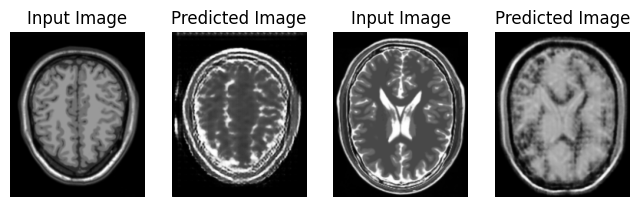

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-49


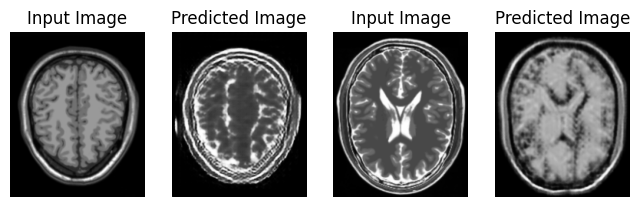

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-50


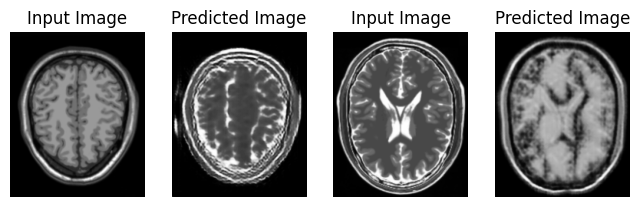

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-51


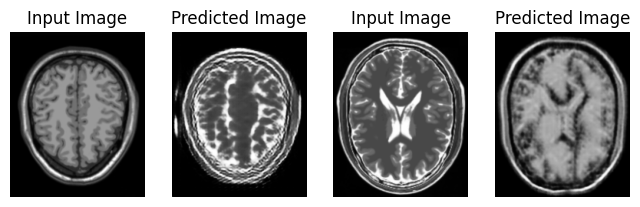

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-52


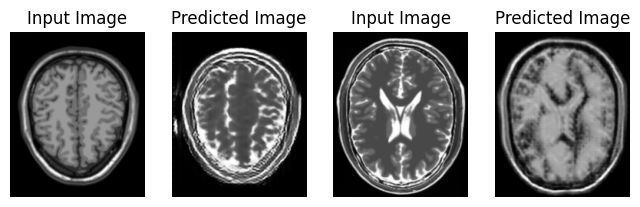

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-53


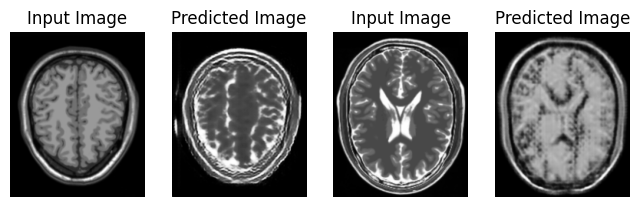

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-54


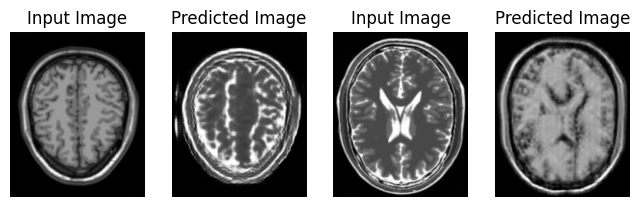

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-55


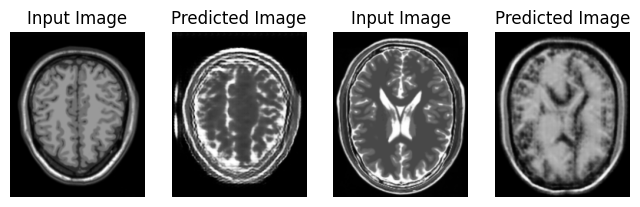

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-56


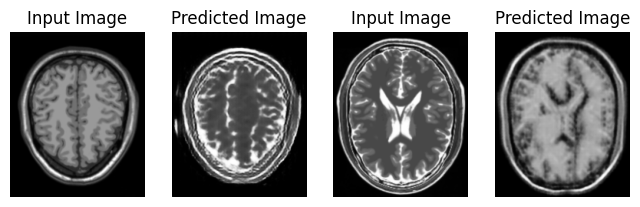

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-57


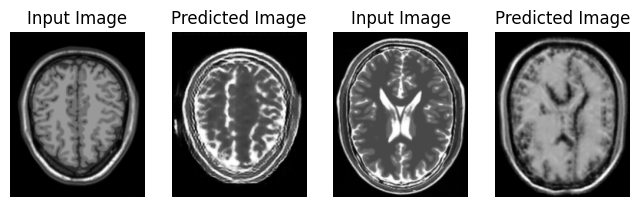

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-58


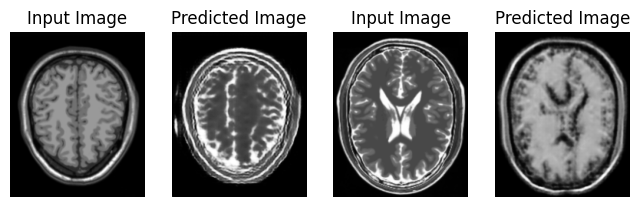

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-59


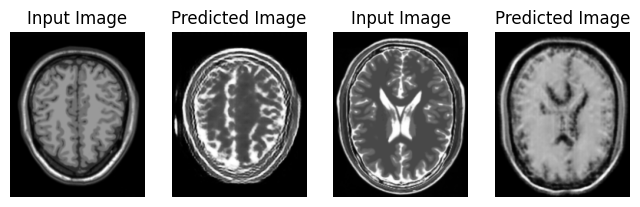

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-60


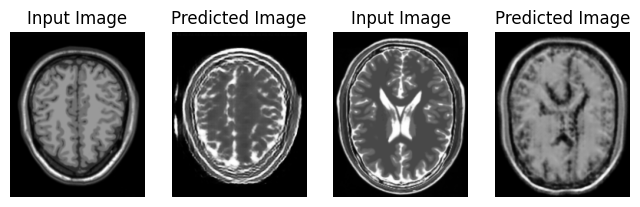

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-61


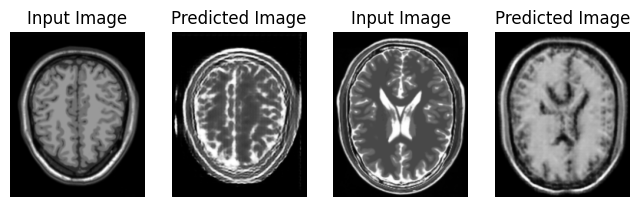

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-62


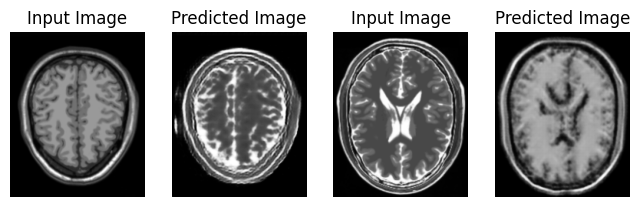

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-63


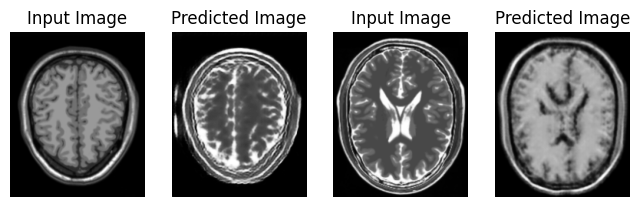

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-64


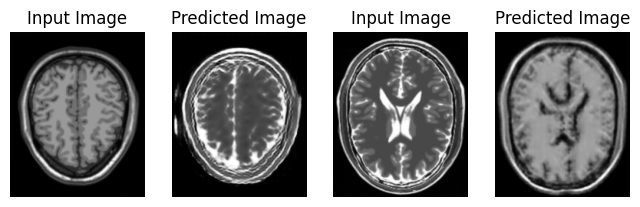

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-65


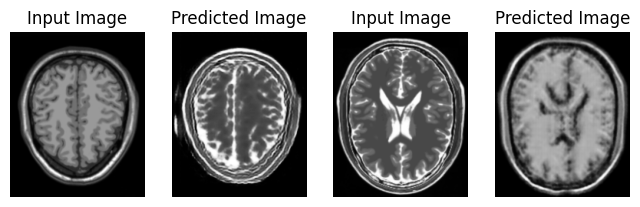

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-66


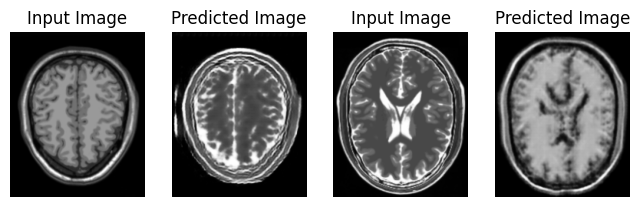

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-67


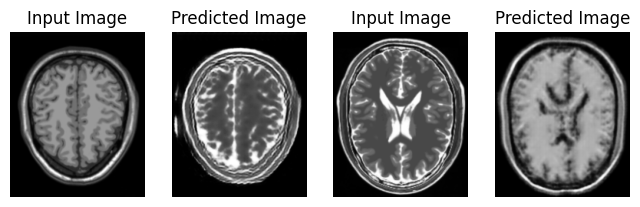

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-68


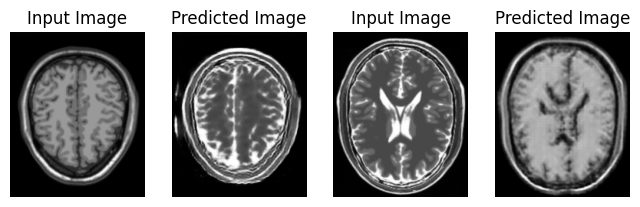

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-69


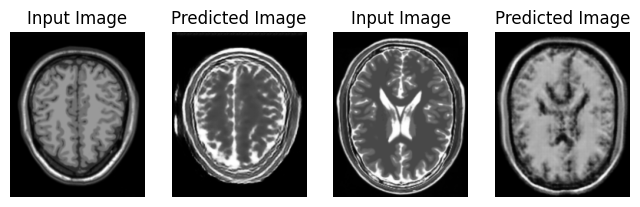

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-70


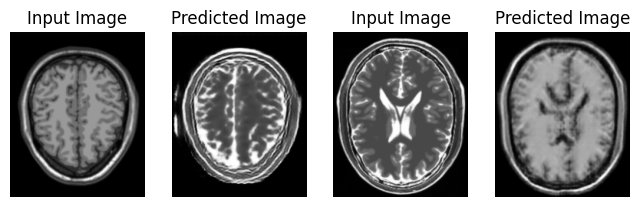

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-71


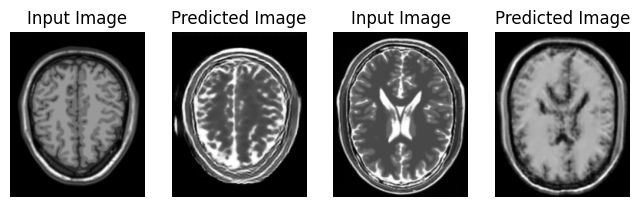

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-72


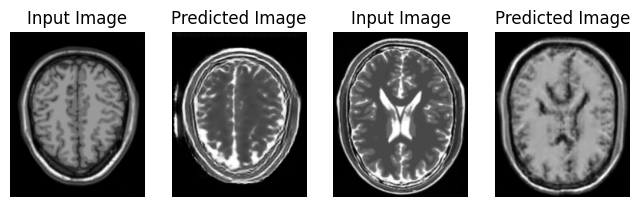

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-73


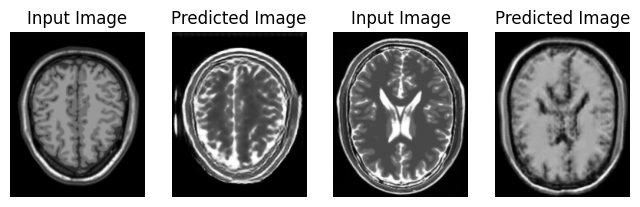

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-74


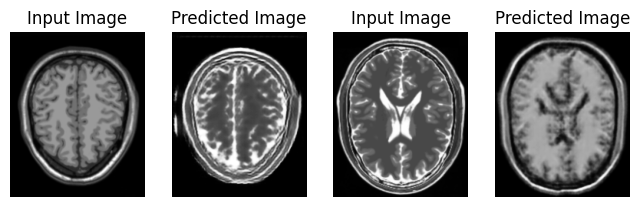

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-75


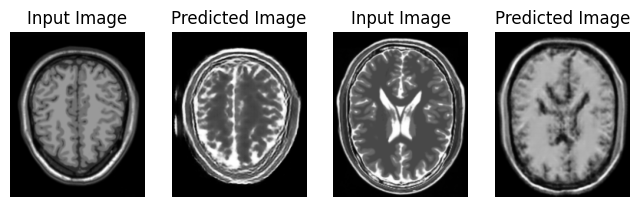

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-76


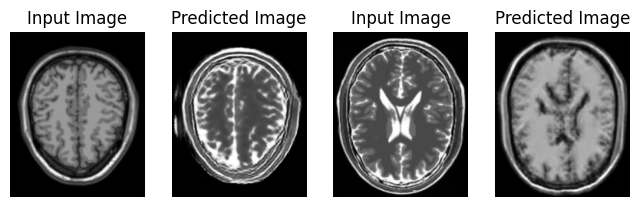

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-77


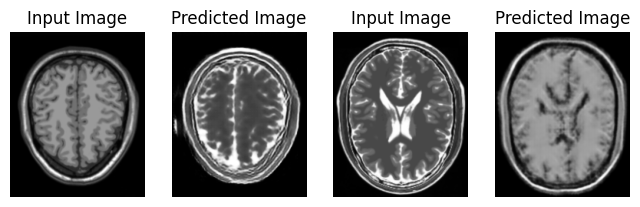

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-78


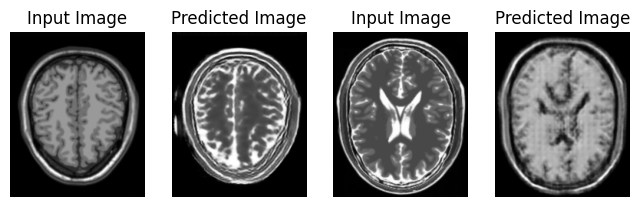

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-79


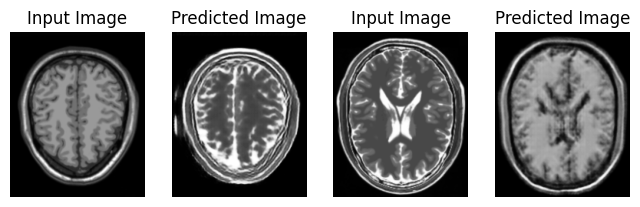

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-80


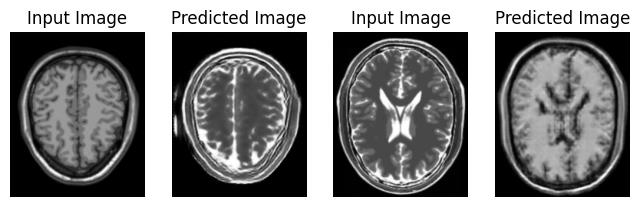

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-81


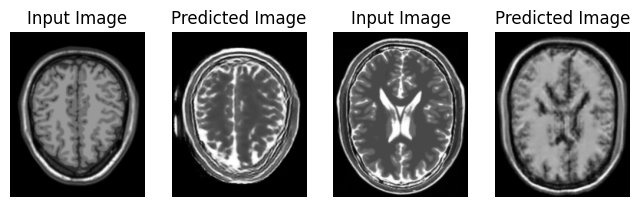

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-82


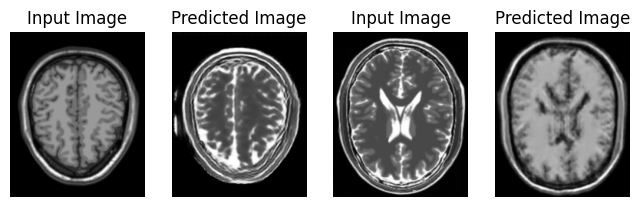

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-83


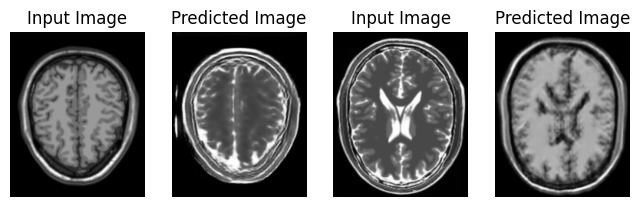

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-84


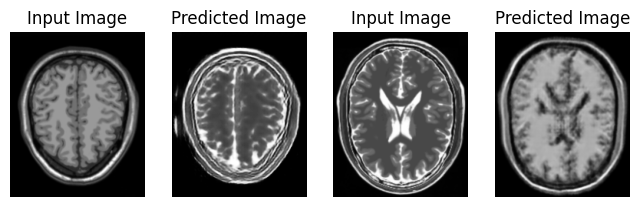

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-85


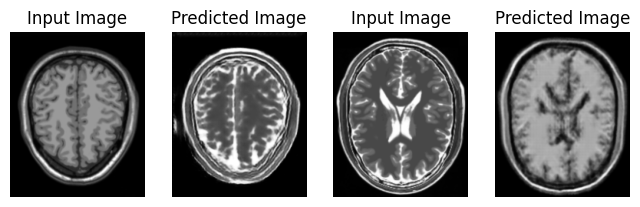

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-86


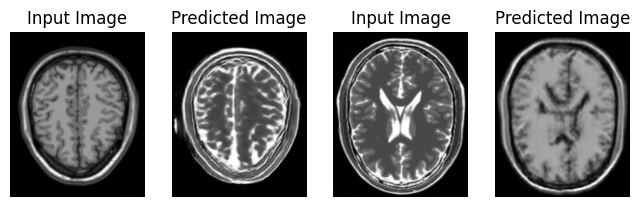

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-87


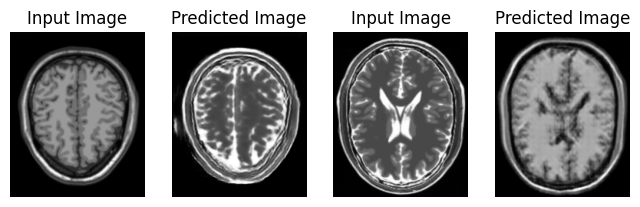

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-88


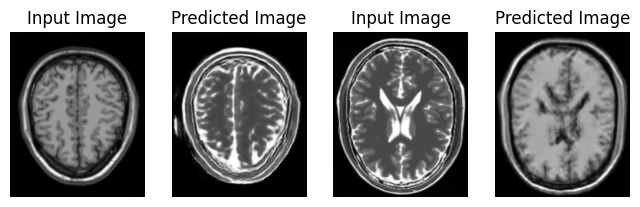

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-89


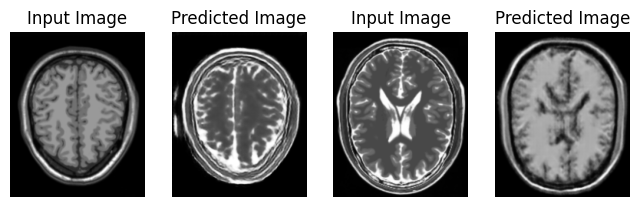

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-90


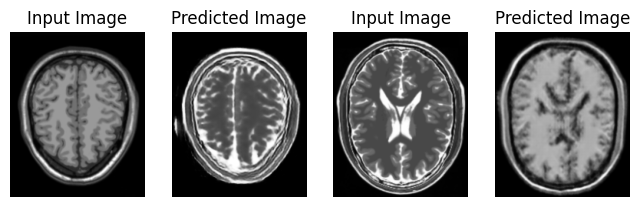

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-91


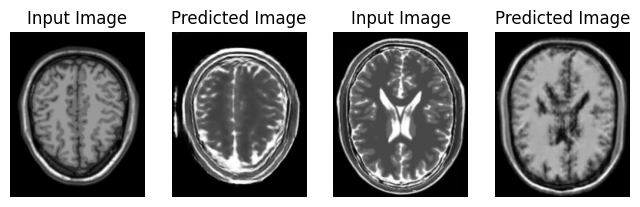

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-92


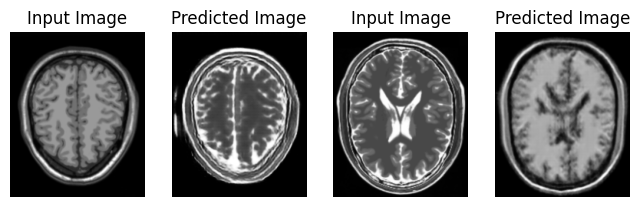

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-93


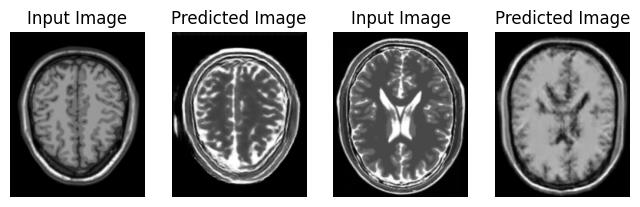

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-94


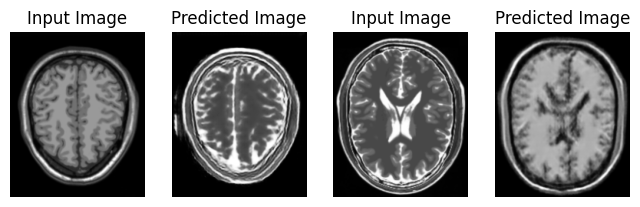

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-95


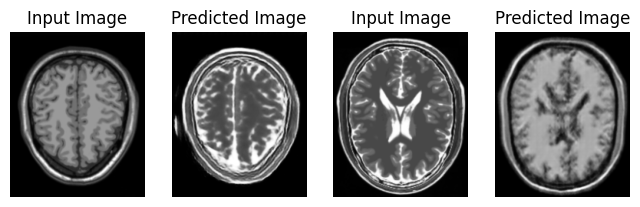

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-96


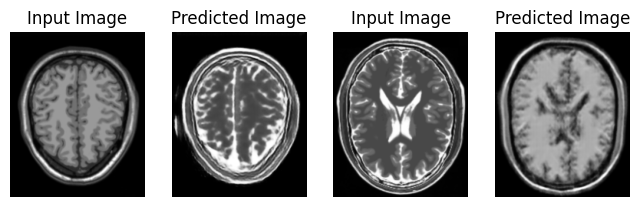

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-97


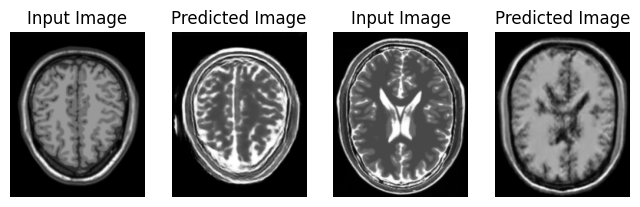

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-98


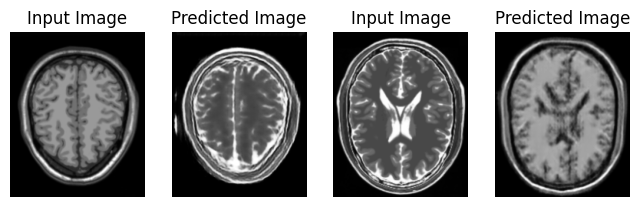

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-99


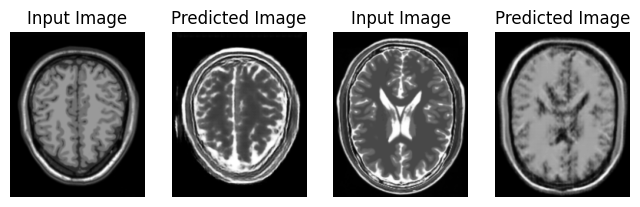

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-100


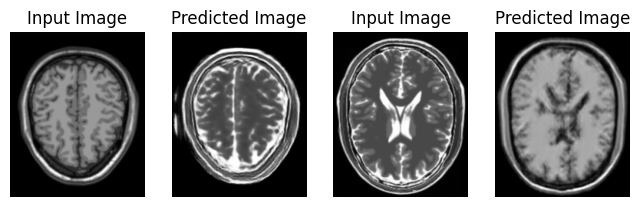

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-101


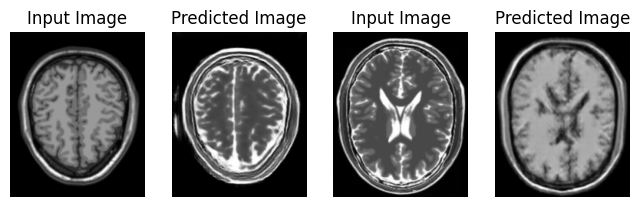

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-102


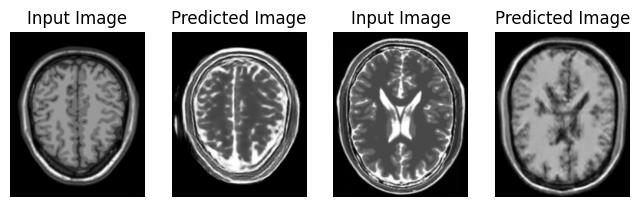

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-103


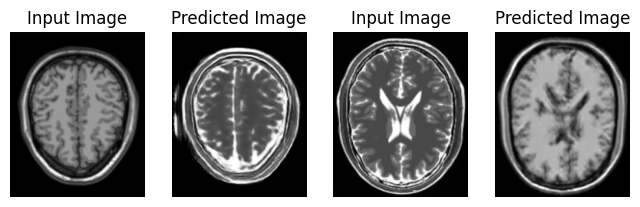

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-104


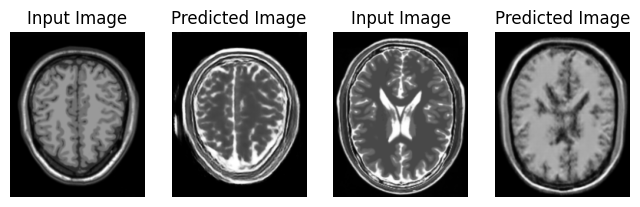

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-105


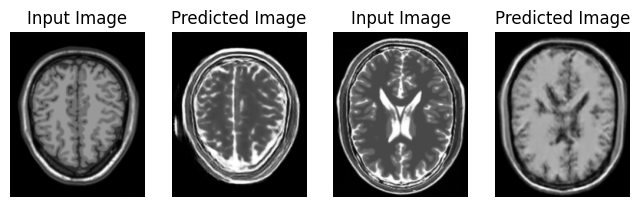

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-106


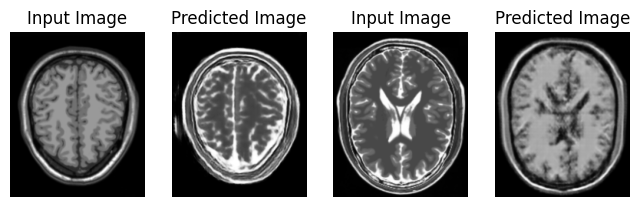

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-107


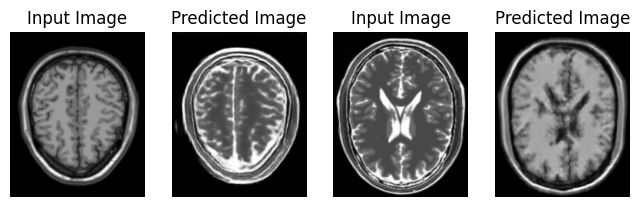

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-108


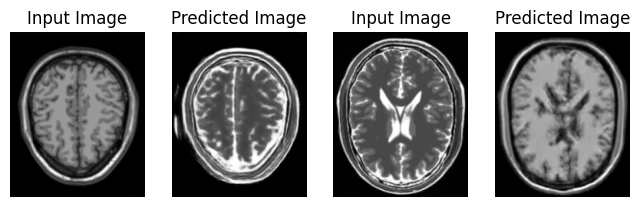

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-109


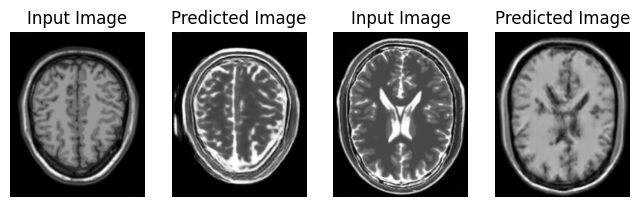

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-110


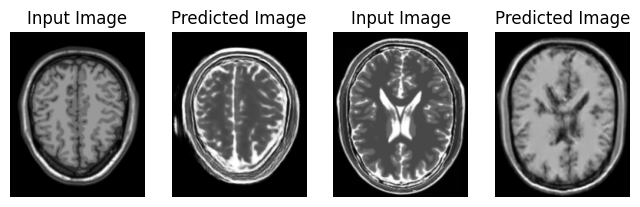

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-111


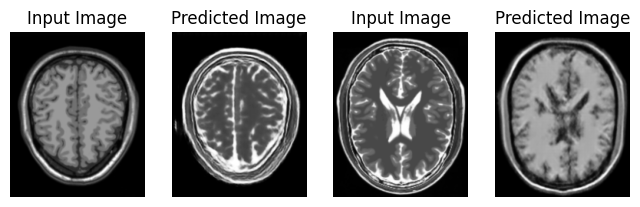

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-112


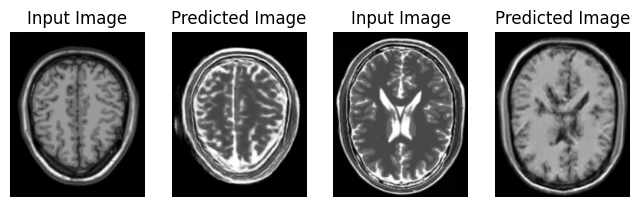

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-113


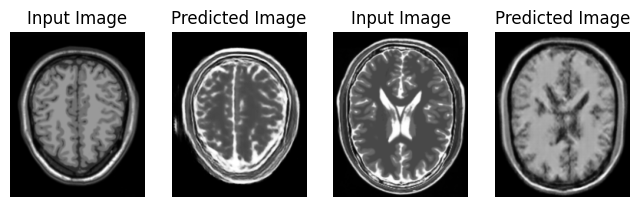

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-114


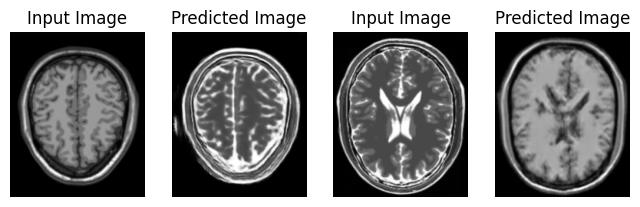

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-115


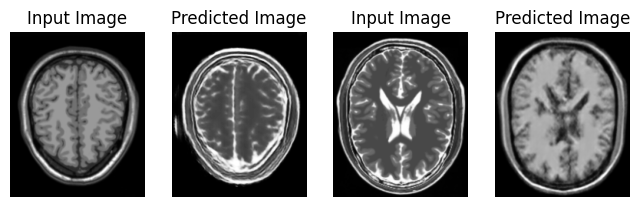

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-116


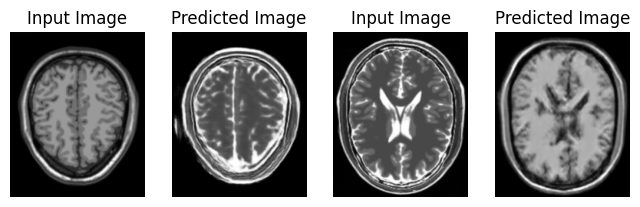

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-117


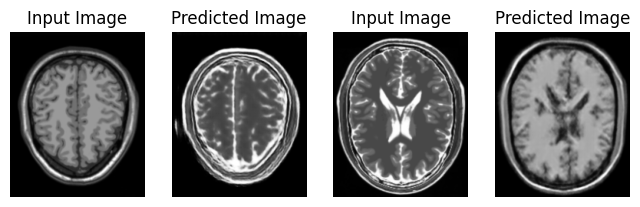

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-118


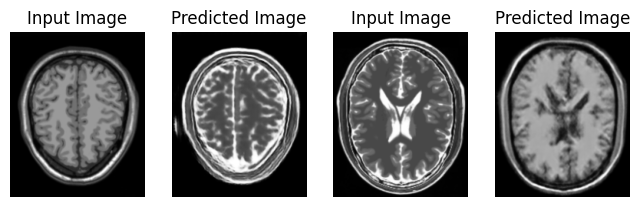

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-119


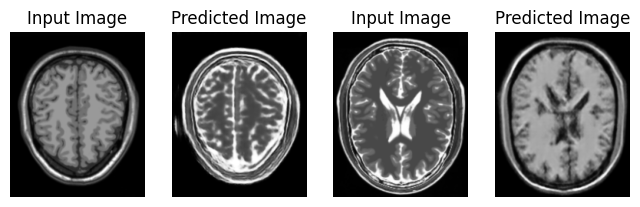

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-120


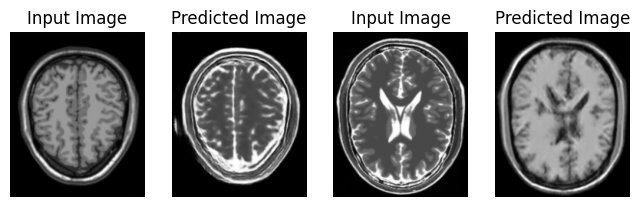

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-121


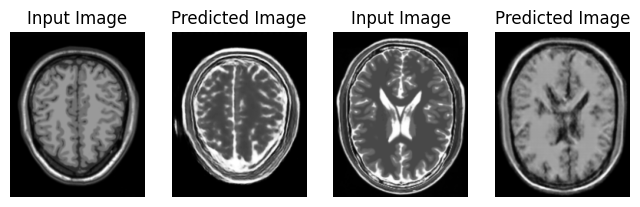

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-122


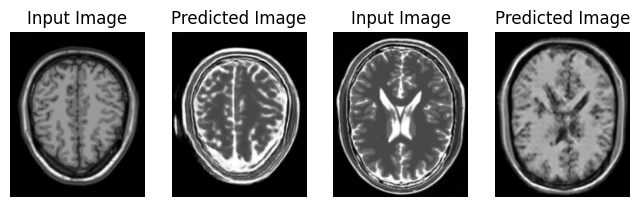

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-123


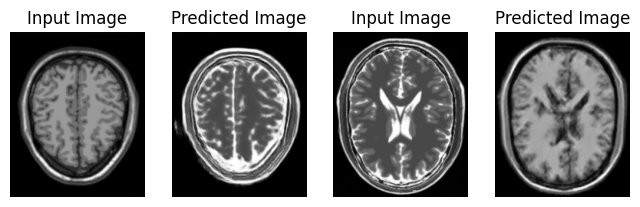

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-124


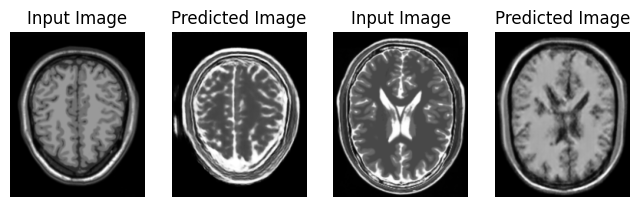

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-125


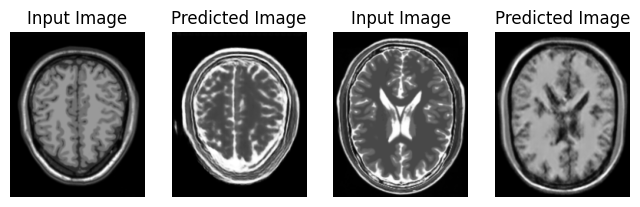

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-126


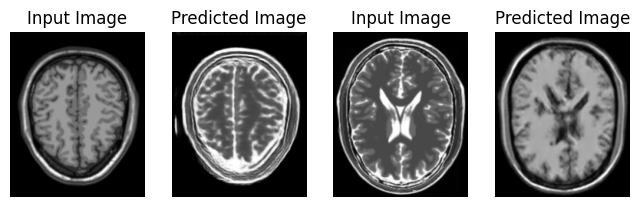

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-127


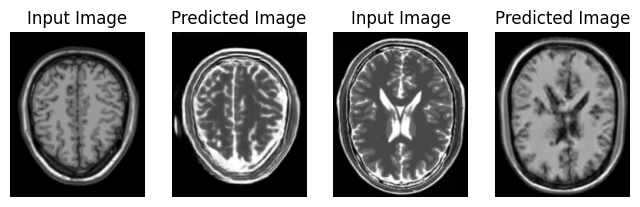

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-128


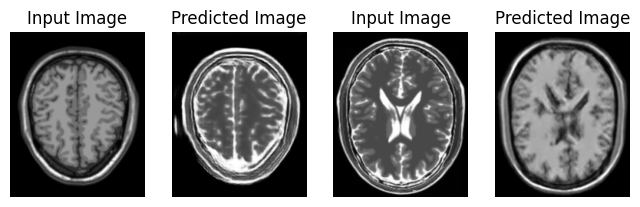

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-129


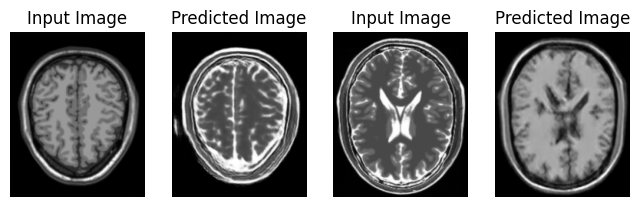

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-130


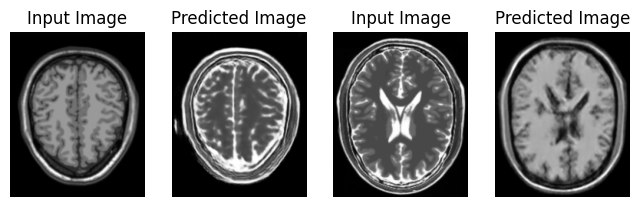

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-131


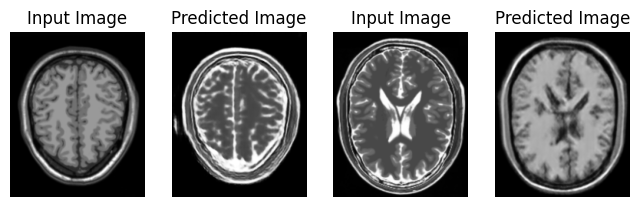

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-132


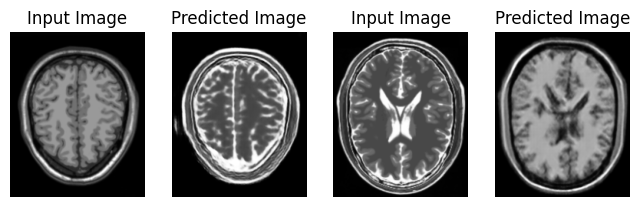

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-133


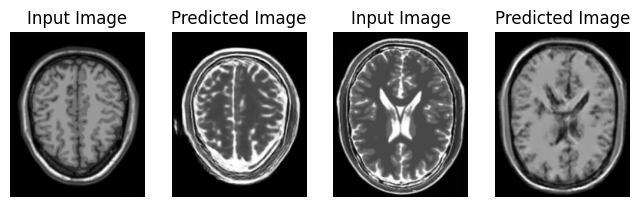

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-134


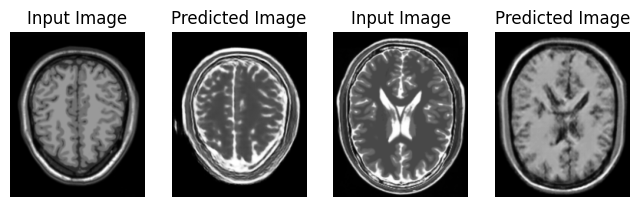

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-135


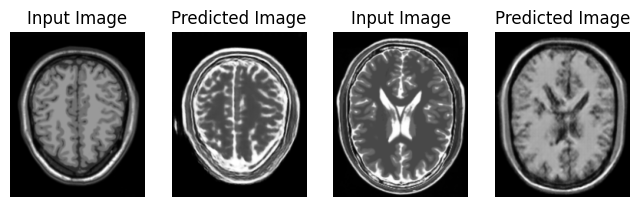

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-136


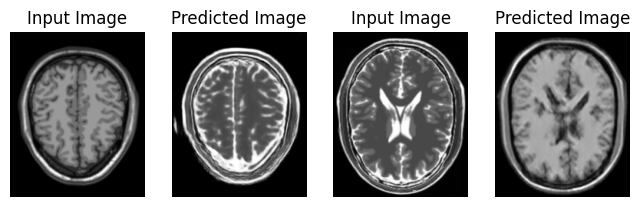

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-137


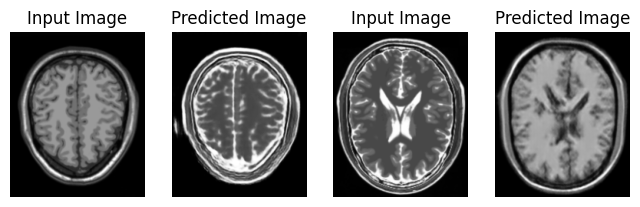

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-138


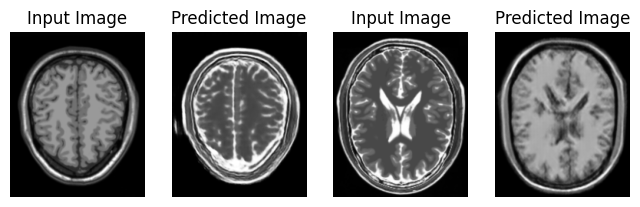

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-139


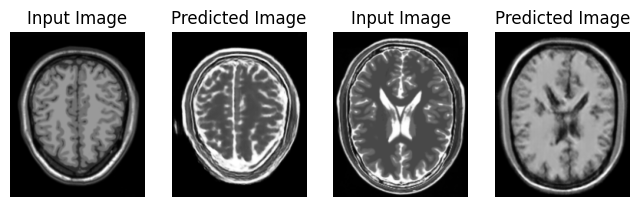

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-140


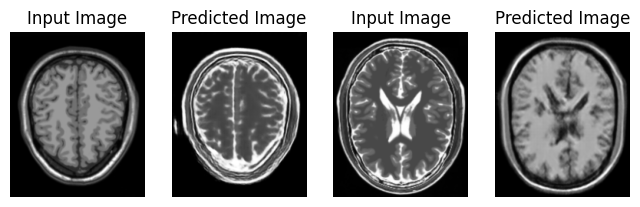

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-141


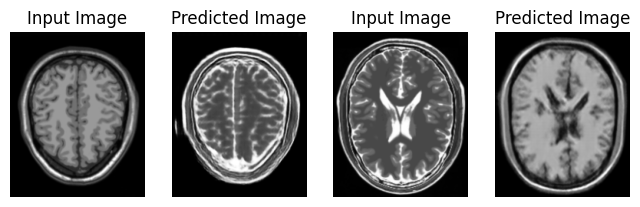

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-142


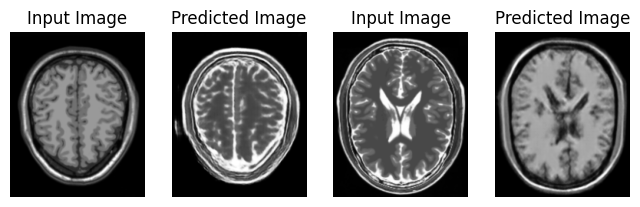

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-143


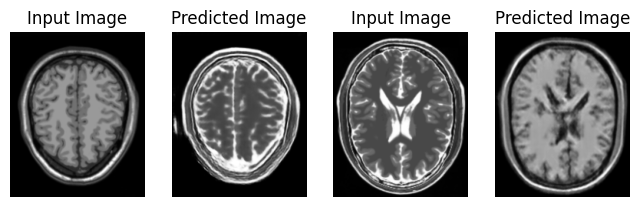

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-144


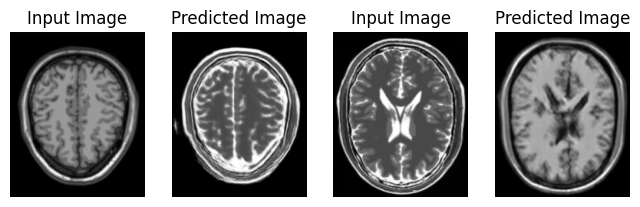

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-145


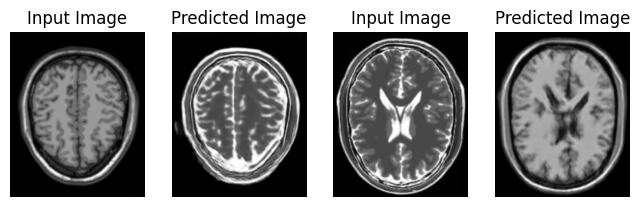

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-146


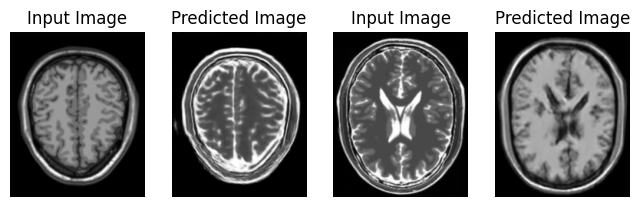

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-147


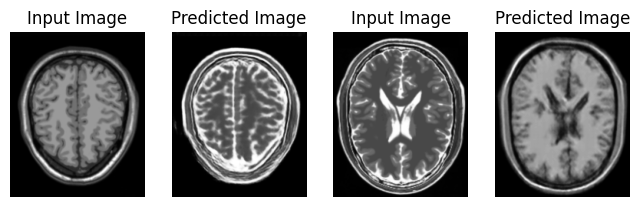

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-148


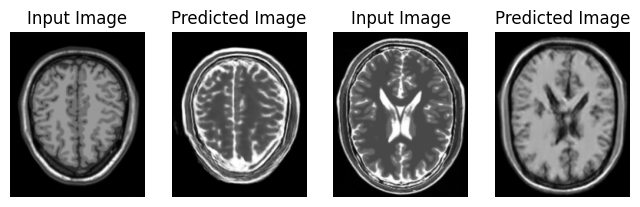

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-149


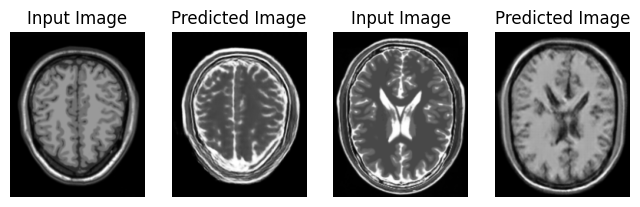

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-150


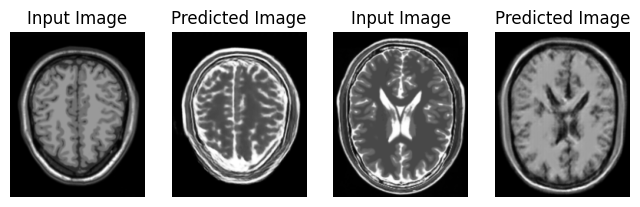

Saving checkpoint for epoch 151 at ./Trained_Model/ckpt-151


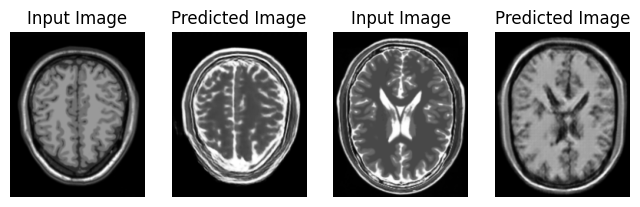

Saving checkpoint for epoch 152 at ./Trained_Model/ckpt-152


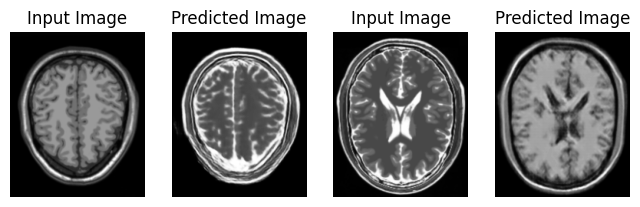

Saving checkpoint for epoch 153 at ./Trained_Model/ckpt-153


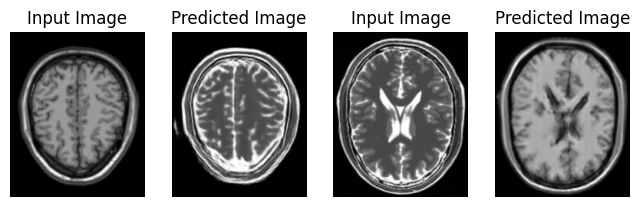

Saving checkpoint for epoch 154 at ./Trained_Model/ckpt-154


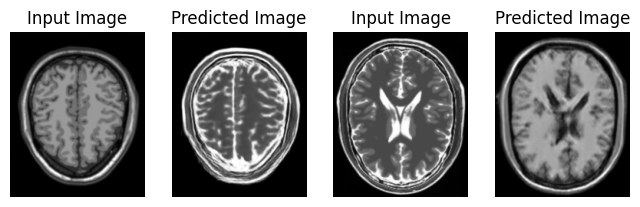

Saving checkpoint for epoch 155 at ./Trained_Model/ckpt-155


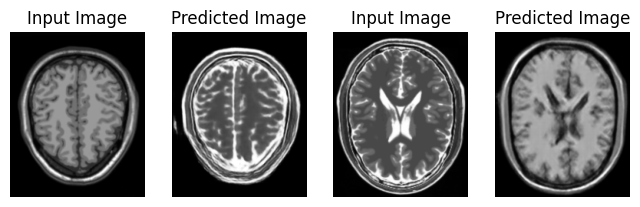

Saving checkpoint for epoch 156 at ./Trained_Model/ckpt-156


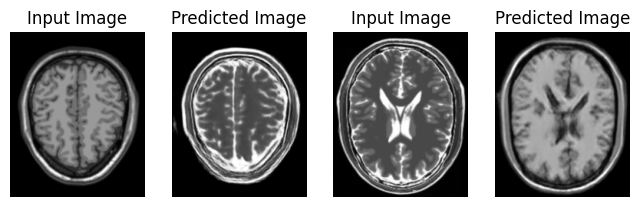

Saving checkpoint for epoch 157 at ./Trained_Model/ckpt-157


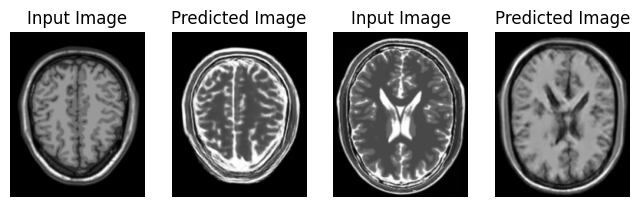

Saving checkpoint for epoch 158 at ./Trained_Model/ckpt-158


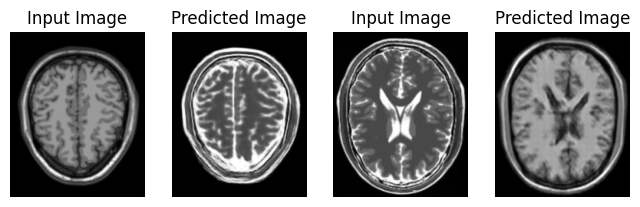

Saving checkpoint for epoch 159 at ./Trained_Model/ckpt-159


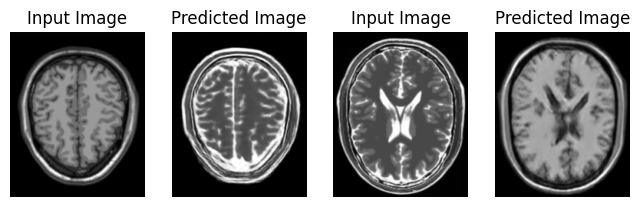

Saving checkpoint for epoch 160 at ./Trained_Model/ckpt-160


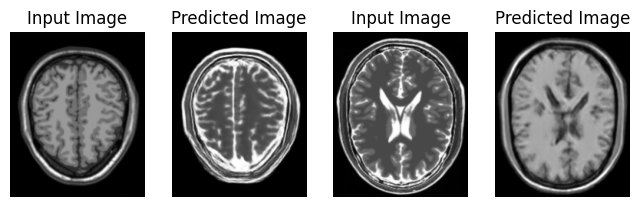

Saving checkpoint for epoch 161 at ./Trained_Model/ckpt-161


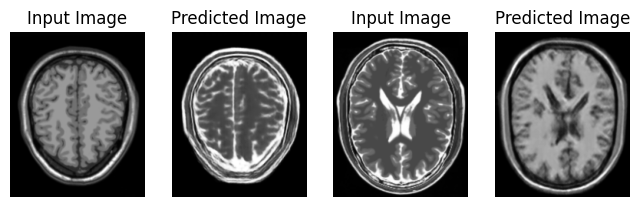

Saving checkpoint for epoch 162 at ./Trained_Model/ckpt-162


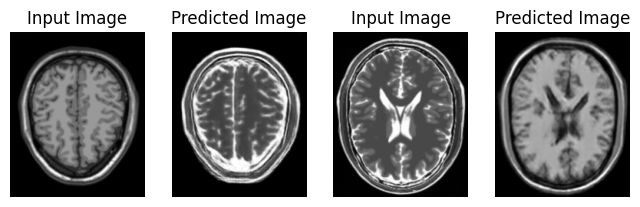

Saving checkpoint for epoch 163 at ./Trained_Model/ckpt-163


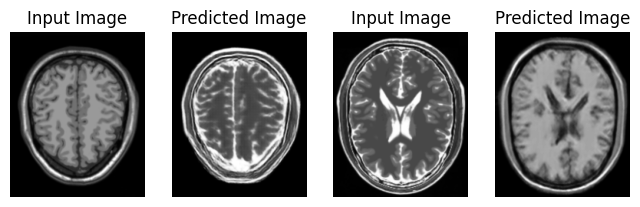

Saving checkpoint for epoch 164 at ./Trained_Model/ckpt-164


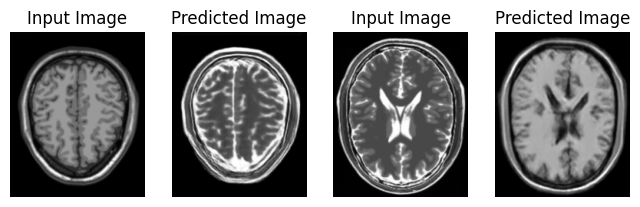

Saving checkpoint for epoch 165 at ./Trained_Model/ckpt-165


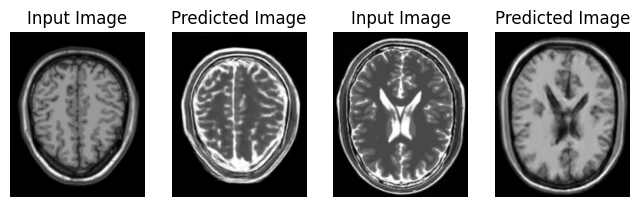

Saving checkpoint for epoch 166 at ./Trained_Model/ckpt-166


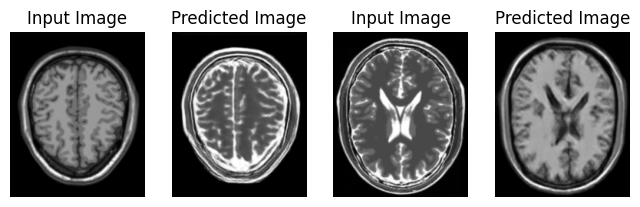

Saving checkpoint for epoch 167 at ./Trained_Model/ckpt-167


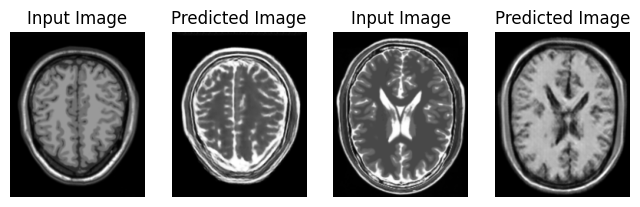

Saving checkpoint for epoch 168 at ./Trained_Model/ckpt-168


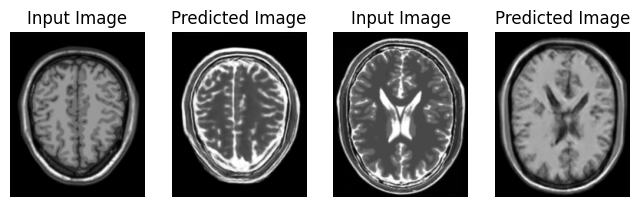

Saving checkpoint for epoch 169 at ./Trained_Model/ckpt-169


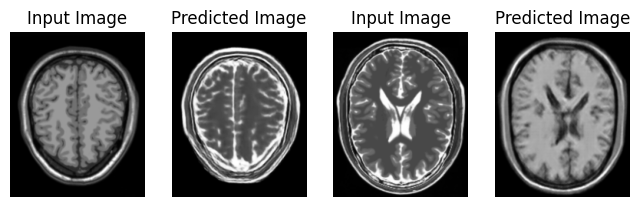

Saving checkpoint for epoch 170 at ./Trained_Model/ckpt-170


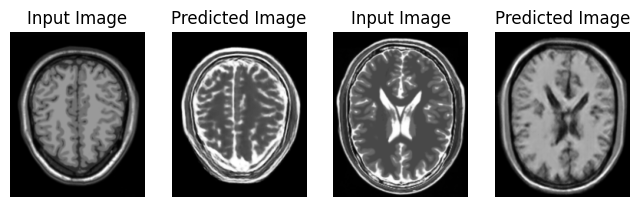

Saving checkpoint for epoch 171 at ./Trained_Model/ckpt-171


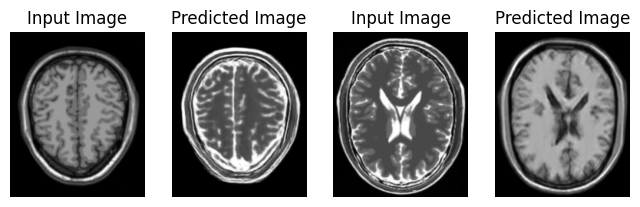

Saving checkpoint for epoch 172 at ./Trained_Model/ckpt-172


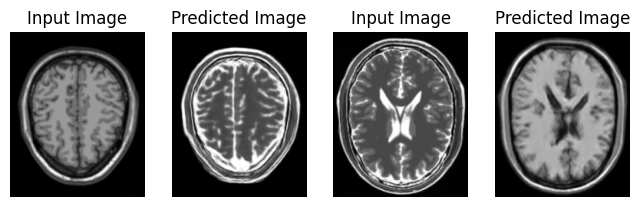

Saving checkpoint for epoch 173 at ./Trained_Model/ckpt-173


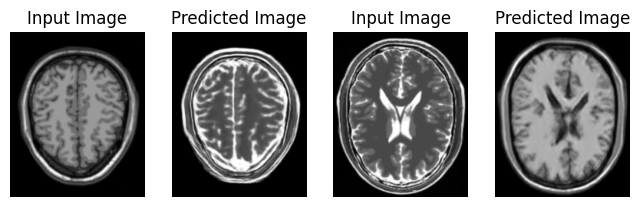

Saving checkpoint for epoch 174 at ./Trained_Model/ckpt-174


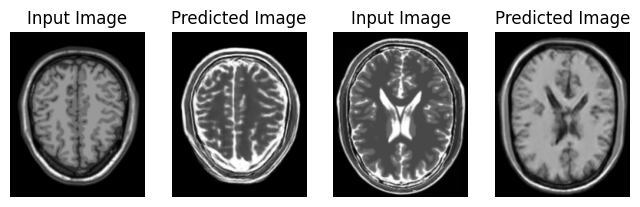

Saving checkpoint for epoch 175 at ./Trained_Model/ckpt-175


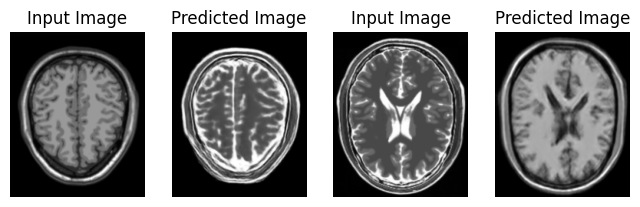

Saving checkpoint for epoch 176 at ./Trained_Model/ckpt-176


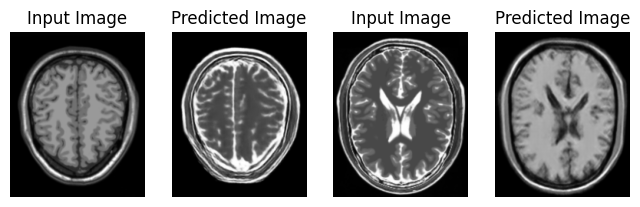

Saving checkpoint for epoch 177 at ./Trained_Model/ckpt-177


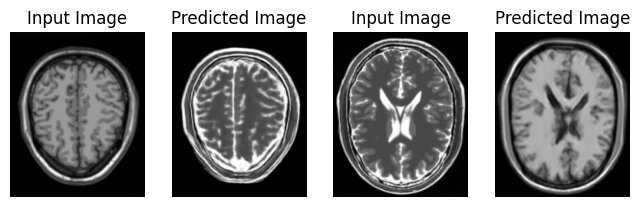

Saving checkpoint for epoch 178 at ./Trained_Model/ckpt-178


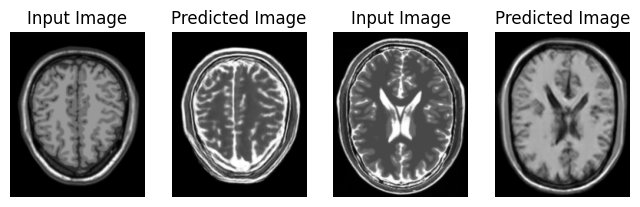

Saving checkpoint for epoch 179 at ./Trained_Model/ckpt-179


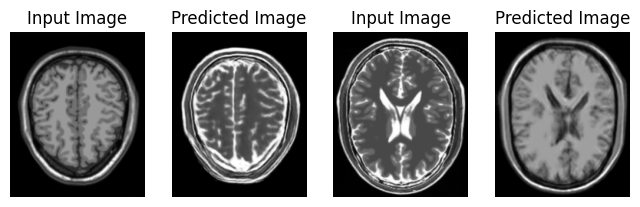

Saving checkpoint for epoch 180 at ./Trained_Model/ckpt-180


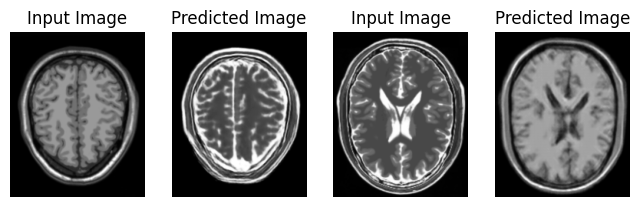

Saving checkpoint for epoch 181 at ./Trained_Model/ckpt-181


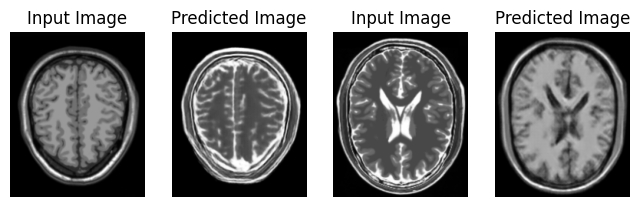

Saving checkpoint for epoch 182 at ./Trained_Model/ckpt-182


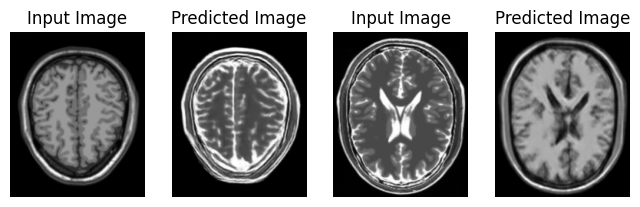

Saving checkpoint for epoch 183 at ./Trained_Model/ckpt-183


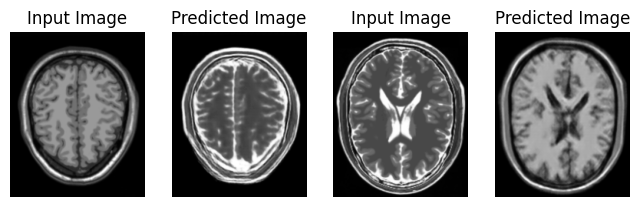

Saving checkpoint for epoch 184 at ./Trained_Model/ckpt-184


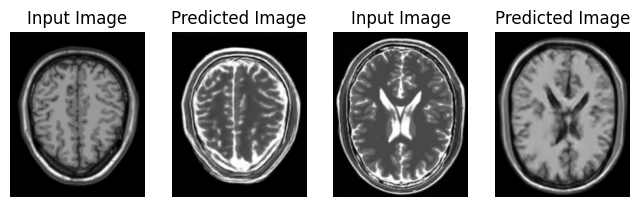

Saving checkpoint for epoch 185 at ./Trained_Model/ckpt-185


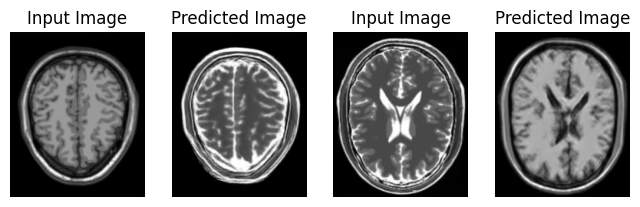

Saving checkpoint for epoch 186 at ./Trained_Model/ckpt-186


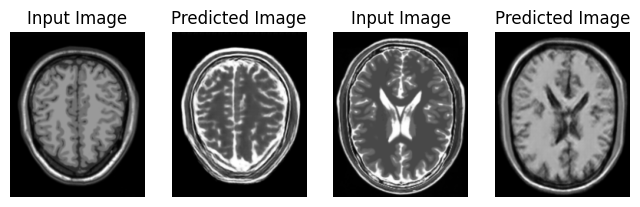

Saving checkpoint for epoch 187 at ./Trained_Model/ckpt-187


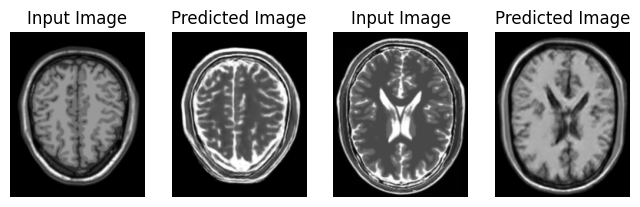

Saving checkpoint for epoch 188 at ./Trained_Model/ckpt-188


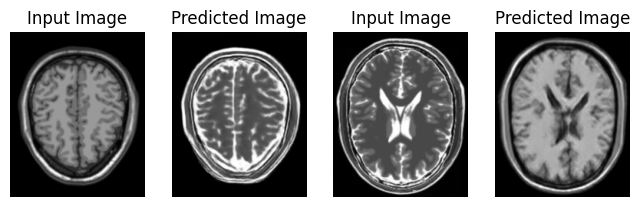

Saving checkpoint for epoch 189 at ./Trained_Model/ckpt-189


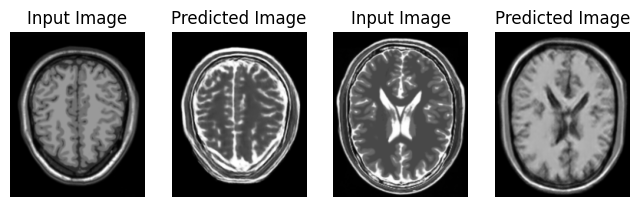

Saving checkpoint for epoch 190 at ./Trained_Model/ckpt-190


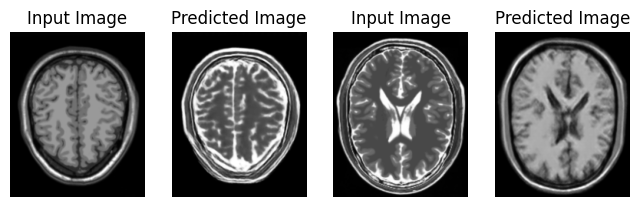

Saving checkpoint for epoch 191 at ./Trained_Model/ckpt-191


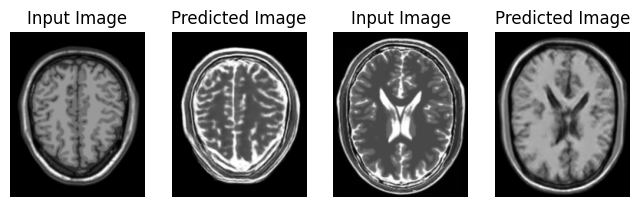

Saving checkpoint for epoch 192 at ./Trained_Model/ckpt-192


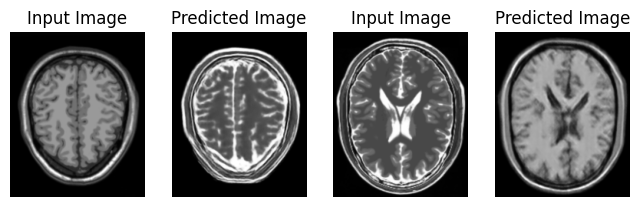

Saving checkpoint for epoch 193 at ./Trained_Model/ckpt-193


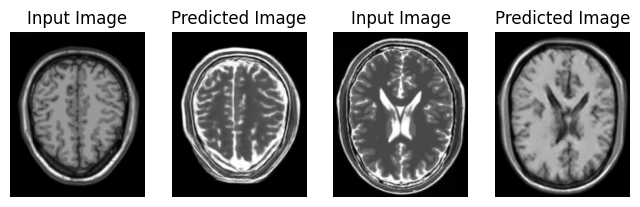

Saving checkpoint for epoch 194 at ./Trained_Model/ckpt-194


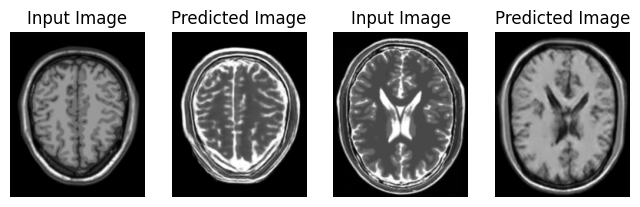

Saving checkpoint for epoch 195 at ./Trained_Model/ckpt-195


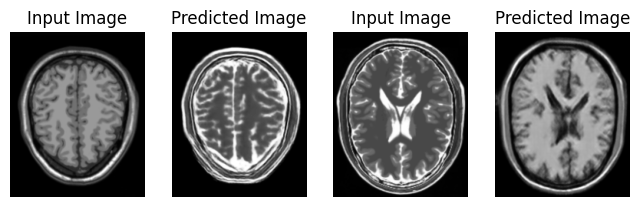

Saving checkpoint for epoch 196 at ./Trained_Model/ckpt-196


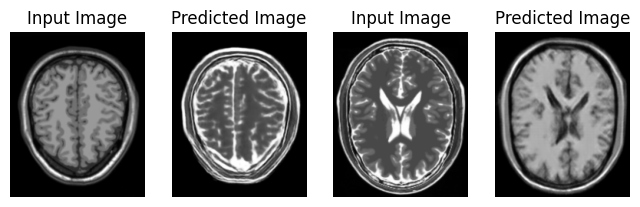

Saving checkpoint for epoch 197 at ./Trained_Model/ckpt-197


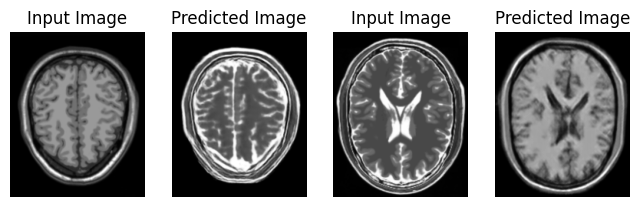

Saving checkpoint for epoch 198 at ./Trained_Model/ckpt-198


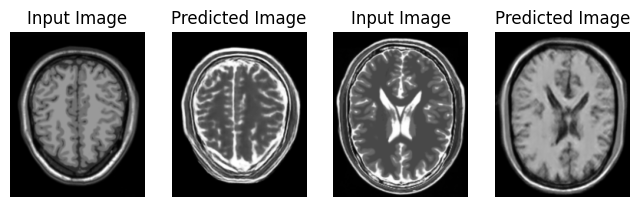

Saving checkpoint for epoch 199 at ./Trained_Model/ckpt-199


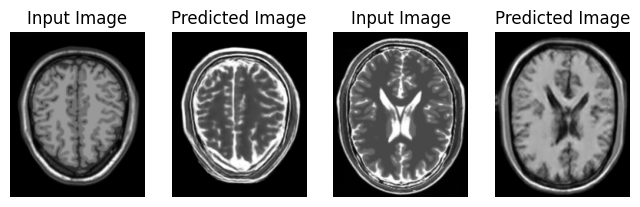

Saving checkpoint for epoch 200 at ./Trained_Model/ckpt-200


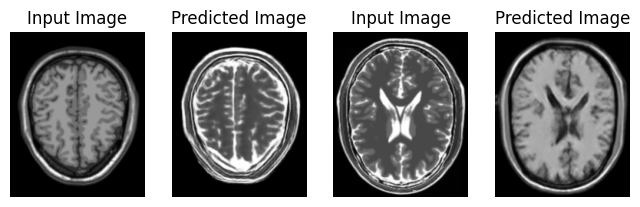

Saving checkpoint for epoch 201 at ./Trained_Model/ckpt-201


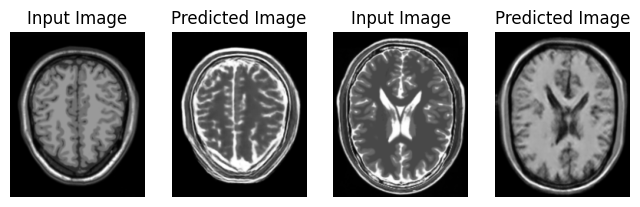

Saving checkpoint for epoch 202 at ./Trained_Model/ckpt-202


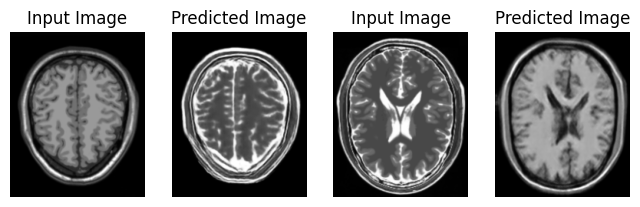

Saving checkpoint for epoch 203 at ./Trained_Model/ckpt-203


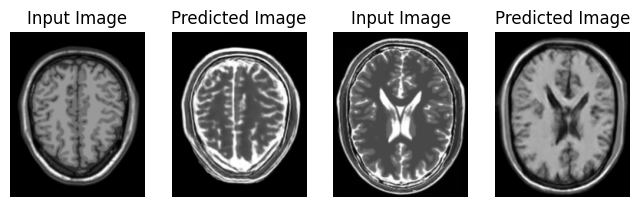

Saving checkpoint for epoch 204 at ./Trained_Model/ckpt-204


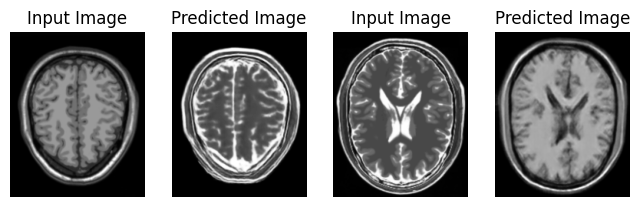

Saving checkpoint for epoch 205 at ./Trained_Model/ckpt-205


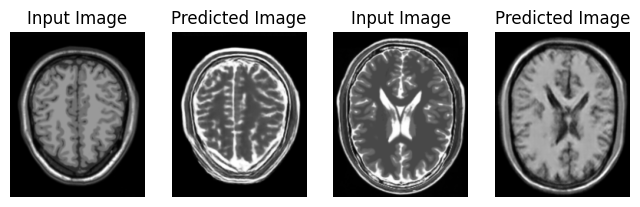

Saving checkpoint for epoch 206 at ./Trained_Model/ckpt-206


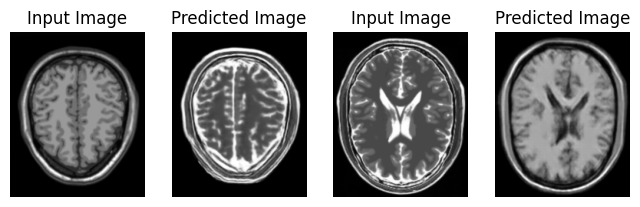

Saving checkpoint for epoch 207 at ./Trained_Model/ckpt-207


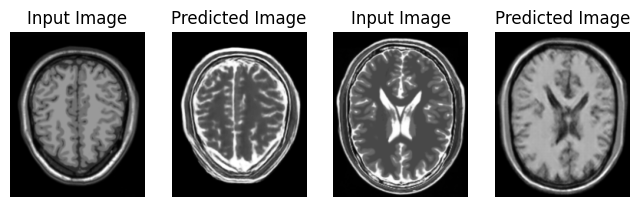

Saving checkpoint for epoch 208 at ./Trained_Model/ckpt-208


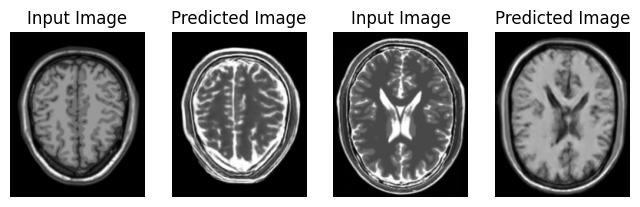

Saving checkpoint for epoch 209 at ./Trained_Model/ckpt-209


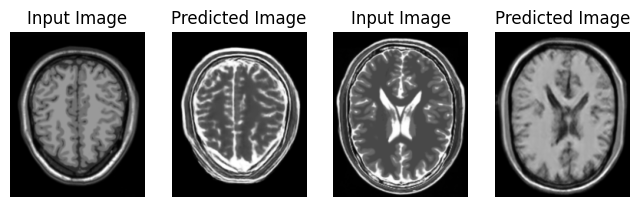

Saving checkpoint for epoch 210 at ./Trained_Model/ckpt-210


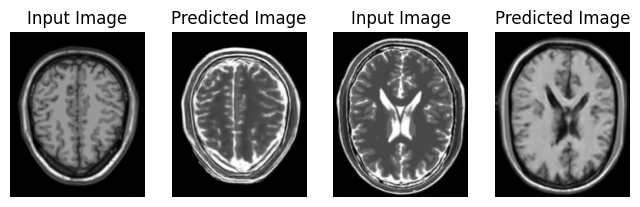

Saving checkpoint for epoch 211 at ./Trained_Model/ckpt-211


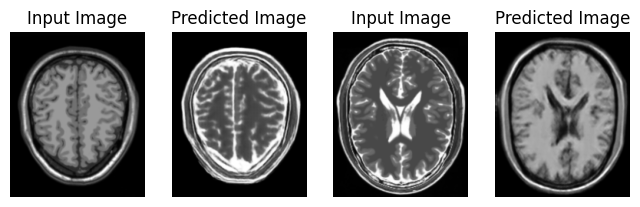

Saving checkpoint for epoch 212 at ./Trained_Model/ckpt-212


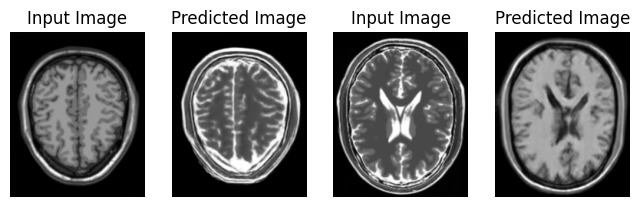

Saving checkpoint for epoch 213 at ./Trained_Model/ckpt-213


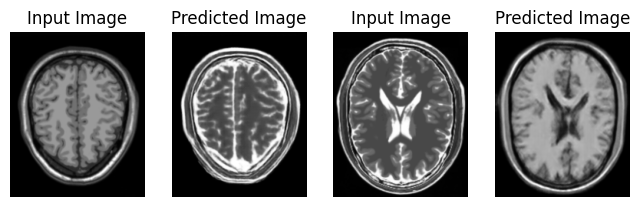

Saving checkpoint for epoch 214 at ./Trained_Model/ckpt-214


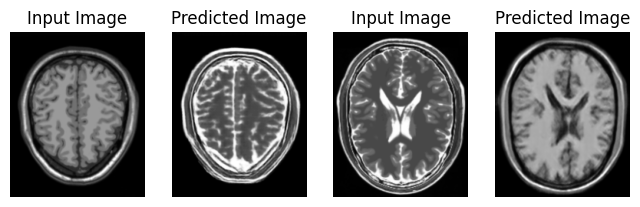

Saving checkpoint for epoch 215 at ./Trained_Model/ckpt-215


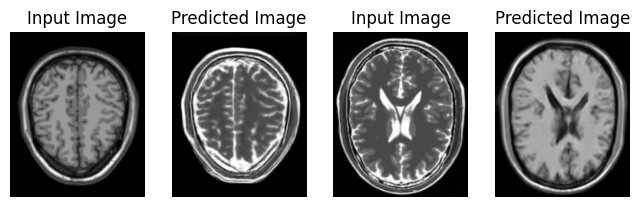

Saving checkpoint for epoch 216 at ./Trained_Model/ckpt-216


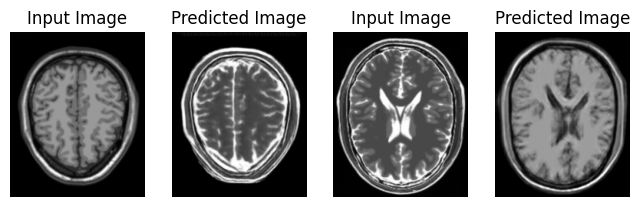

Saving checkpoint for epoch 217 at ./Trained_Model/ckpt-217


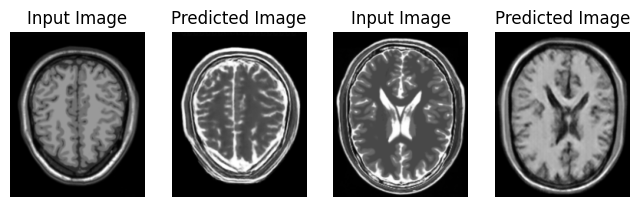

Saving checkpoint for epoch 218 at ./Trained_Model/ckpt-218


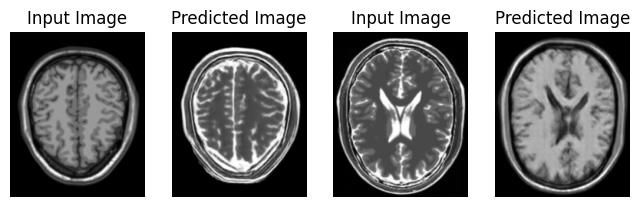

Saving checkpoint for epoch 219 at ./Trained_Model/ckpt-219


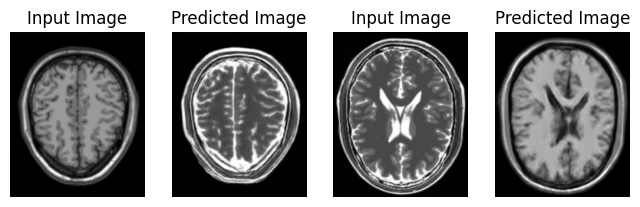

Saving checkpoint for epoch 220 at ./Trained_Model/ckpt-220


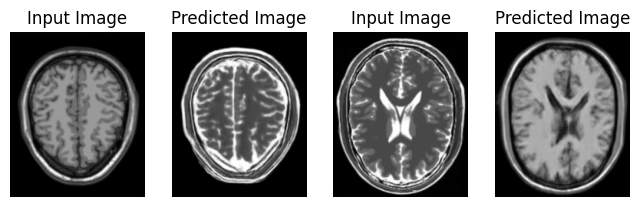

Saving checkpoint for epoch 221 at ./Trained_Model/ckpt-221


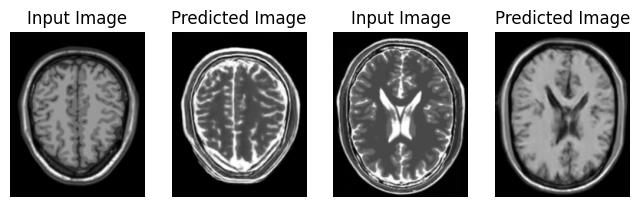

Saving checkpoint for epoch 222 at ./Trained_Model/ckpt-222


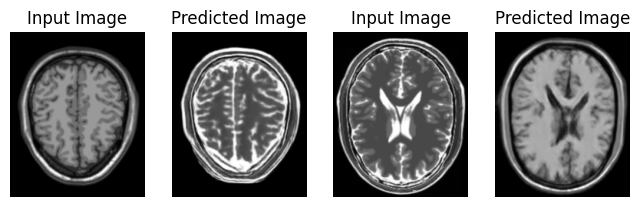

Saving checkpoint for epoch 223 at ./Trained_Model/ckpt-223


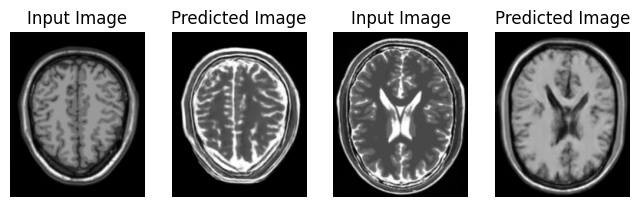

Saving checkpoint for epoch 224 at ./Trained_Model/ckpt-224


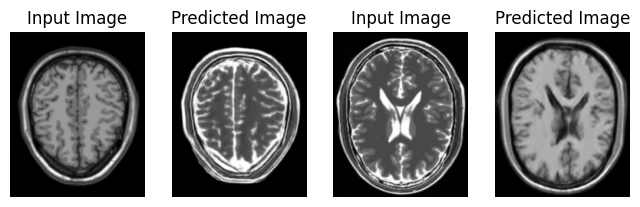

Saving checkpoint for epoch 225 at ./Trained_Model/ckpt-225


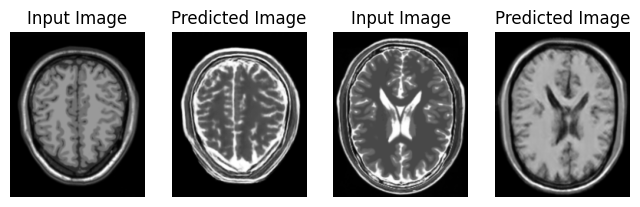

Saving checkpoint for epoch 226 at ./Trained_Model/ckpt-226


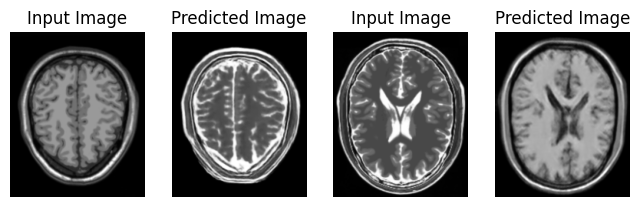

Saving checkpoint for epoch 227 at ./Trained_Model/ckpt-227


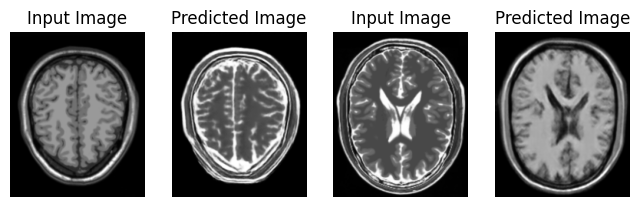

Saving checkpoint for epoch 228 at ./Trained_Model/ckpt-228


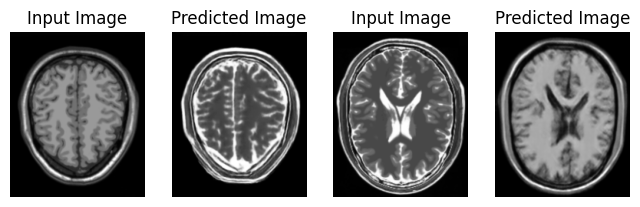

Saving checkpoint for epoch 229 at ./Trained_Model/ckpt-229


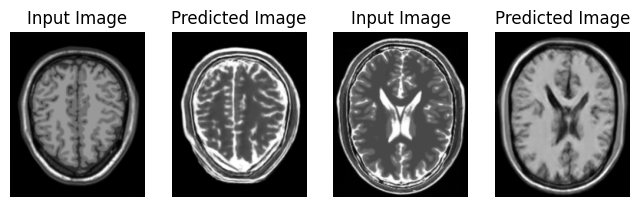

Saving checkpoint for epoch 230 at ./Trained_Model/ckpt-230


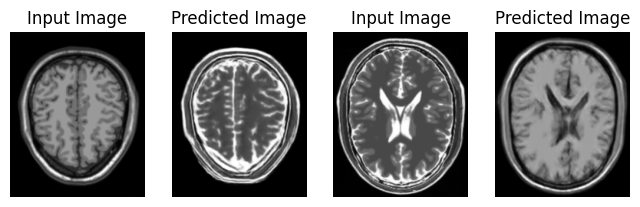

Saving checkpoint for epoch 231 at ./Trained_Model/ckpt-231


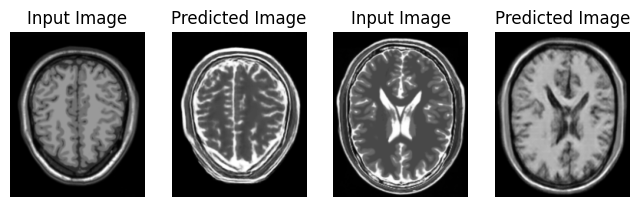

Saving checkpoint for epoch 232 at ./Trained_Model/ckpt-232


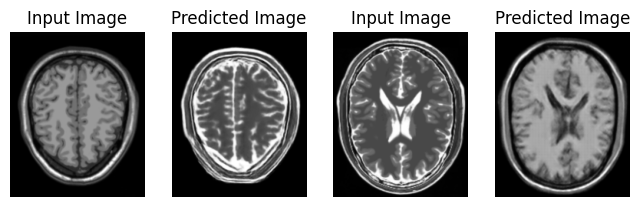

Saving checkpoint for epoch 233 at ./Trained_Model/ckpt-233


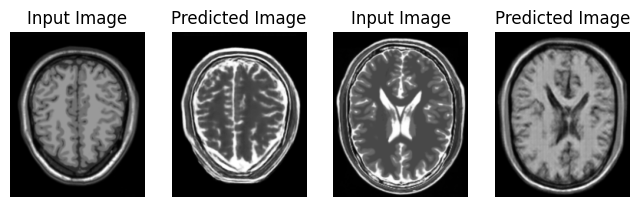

Saving checkpoint for epoch 234 at ./Trained_Model/ckpt-234


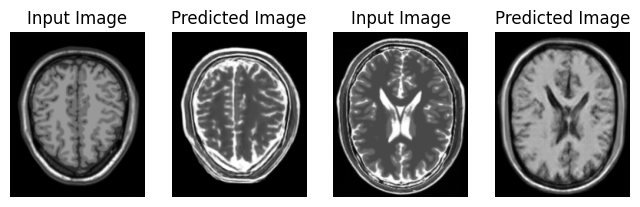

Saving checkpoint for epoch 235 at ./Trained_Model/ckpt-235


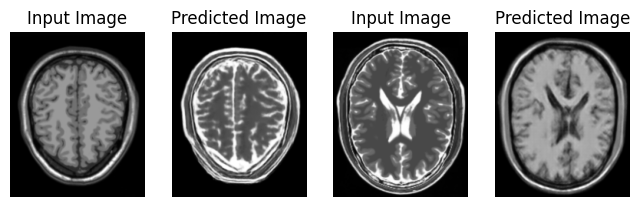

Saving checkpoint for epoch 236 at ./Trained_Model/ckpt-236


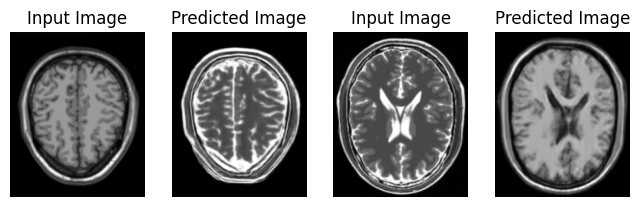

Saving checkpoint for epoch 237 at ./Trained_Model/ckpt-237


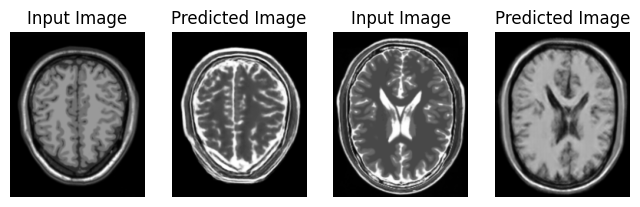

Saving checkpoint for epoch 238 at ./Trained_Model/ckpt-238


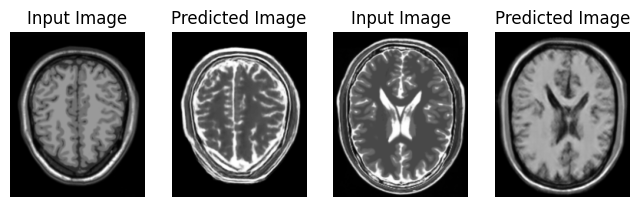

Saving checkpoint for epoch 239 at ./Trained_Model/ckpt-239


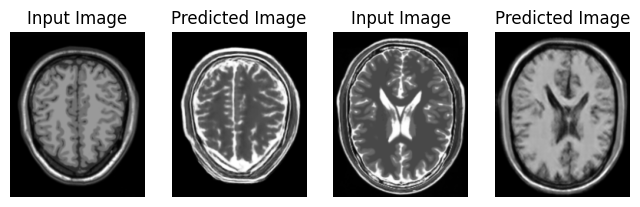

Saving checkpoint for epoch 240 at ./Trained_Model/ckpt-240


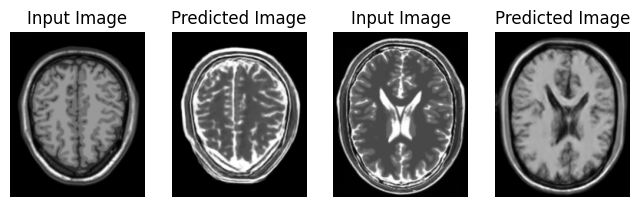

Saving checkpoint for epoch 241 at ./Trained_Model/ckpt-241


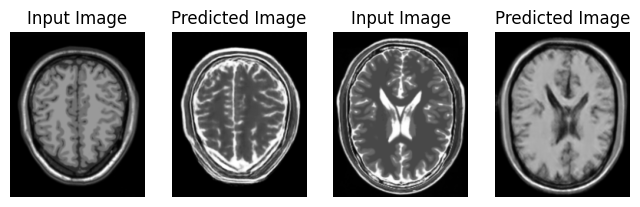

Saving checkpoint for epoch 242 at ./Trained_Model/ckpt-242


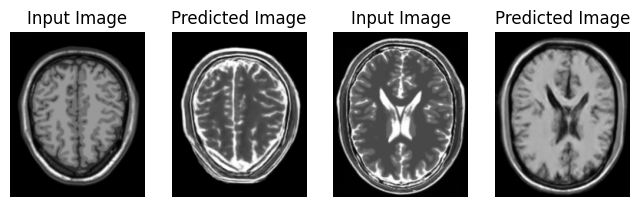

Saving checkpoint for epoch 243 at ./Trained_Model/ckpt-243


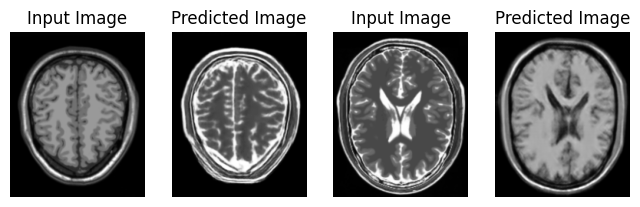

Saving checkpoint for epoch 244 at ./Trained_Model/ckpt-244


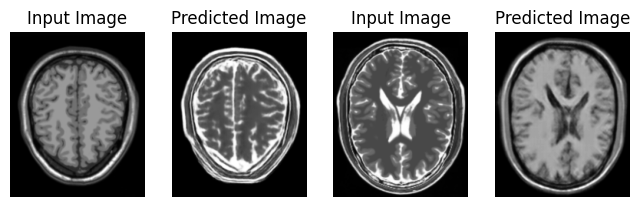

Saving checkpoint for epoch 245 at ./Trained_Model/ckpt-245


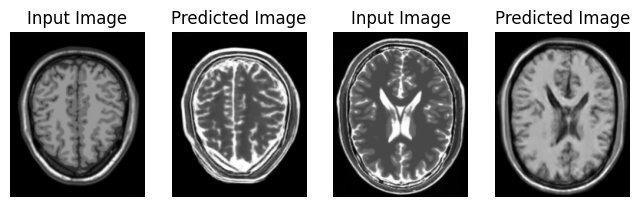

Saving checkpoint for epoch 246 at ./Trained_Model/ckpt-246


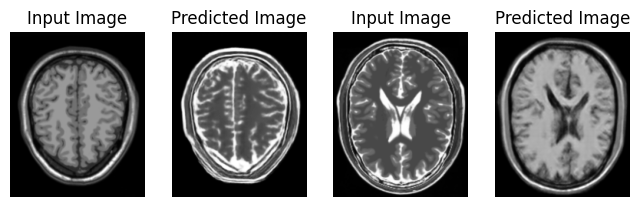

Saving checkpoint for epoch 247 at ./Trained_Model/ckpt-247


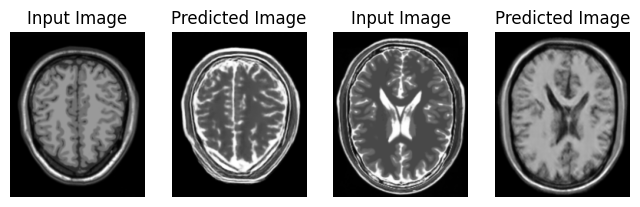

Saving checkpoint for epoch 248 at ./Trained_Model/ckpt-248


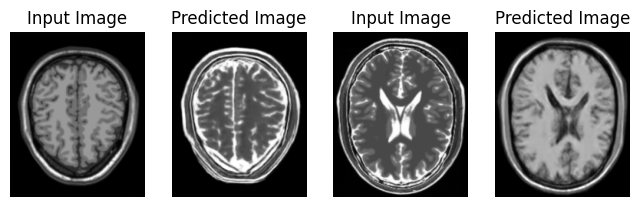

Saving checkpoint for epoch 249 at ./Trained_Model/ckpt-249


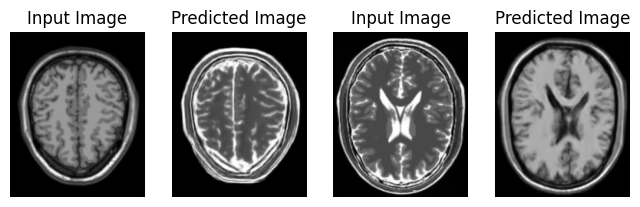

Saving checkpoint for epoch 250 at ./Trained_Model/ckpt-250


In [92]:
for epoch in range(1, EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((t1_images_data, t2_images_data)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_t1_images_data, generator_f, sample_t2_images_data)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

###Generating a GIF for visualization of Results
Notice the Quality of results we are getting.

In [93]:
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-93-881152fae14d>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-93-881152fae14d>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


In [95]:
!pip install git+https://github.com/tensorflow/docs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-mqkkcpmc
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-mqkkcpmc
  Resolved https://github.com/tensorflow/docs to commit 84bd7bea0c468667dd0ec273d426ed50f23e1a15
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=182618 sha256=794485c0860d3d6c27ce76b4673e85e28afb10c26761d067c5d04e84f04ee75d
  Stored in directory: /tmp/pip-ephem-wheel-cache-ub6w87wj/wheels/fc/f8/3b/5d21409a59cb1be9b1ade11f682039ced75b84de9dd6a0c8de
Successfully built tensorflow-docs


In [96]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)